In [1]:
# conda base
import pandas as pd 
import numpy as np
import networkx as nx

import matplotlib.pyplot as plt 
import seaborn as sns

from scipy.spatial import distance
from sklearn.metrics import pairwise
from sklearn.cluster import KMeans
from sklearn.metrics.cluster import adjusted_rand_score
from scipy.cluster.hierarchy import dendrogram , linkage , fcluster
from itertools import combinations

In [2]:
# load data 
df  = pd.read_parquet("../bldb/clean/csv/bldb_dset.parquet")
sbl = df[df.bla_class.str.contains("class_a|class_c|class_d")]
mbl = df[df.bla_class.str.contains("class_b1|class_b2|class_b3")]

# load tsne
tsne_sbl = pd.read_parquet("../bldb/lowdim/tsne/csv/tsne_sbl_all_models.csv")
tsne_mbl = pd.read_parquet("../bldb/lowdim/tsne/csv/tsne_mbl_all_models.csv")

# merge 
sbl = sbl.merge(tsne_sbl, on="seq_id", how="inner")
mbl = mbl.merge(tsne_mbl, on="seq_id", how="inner")

# split
sbl_a = sbl[sbl.bla_class == "class_a"]
sbl_c = sbl[sbl.bla_class == "class_c"]
sbl_d = sbl[sbl.bla_class == "class_d"]

mbl_b1 = mbl[mbl.bla_class == "class_b1"]
mbl_b2 = mbl[mbl.bla_class == "class_b2"]
mbl_b3 = mbl[mbl.bla_class == "class_b3"]
mbl_me = mbl[mbl.bla_class.str.contains("class_b3")]
mbl_mb = mbl[~mbl.bla_class.str.contains("class_b3")]

# filter
sbl_a  = sbl_a[(sbl_a.tsne1_esm1b_400.between(-80,30))]
sbl_d  = sbl_d[(sbl_d.tsne1_esm1b_400.between(-40,30))]
mbl_me = mbl_me[(mbl_me.tsne1_esm1b_400.between(0,40))]

# print info
print(sbl.columns.to_list())

['#name', 'seq', 'length', 'filename', 'bla_class', 'protein_name', 'protein_family_filename', 'superfamily', 'protein_family', 'top_fam', 'seq_id', 'ambler_class', 'alternative_protein_name', 'subfamily', 'genpept_id', 'genbank_id', 'pubmed_id', 'seq_url', 'pdb_structures', 'mutants', 'phenotype', 'functional_info', 'source', 'bitscore', 'Domain', 'Phylum', 'Class', 'Order', 'Family', 'Genus', 'Species', 'phylo_group', 'phylo_group_genus', 'phylo_group_sp', 'bla_subclass', 'esm1b', 'esm2_650m', 'esm2_3b', 'carp', 't5xlu50', 'molecular_weight', 'aromaticity', 'instability', 'gravy', 'isoelectric_point', 'entropy', 'helix', 'turn', 'sheet', 'pass_the_filter', 'is_clust_rep_30', 'is_clust_rep_60', 'is_clust_rep_90', 'has_af2_model', 'model', 'mean_plddt', 'resid_plddt', 'entryId', 'gene', 'uniprotAccession', 'uniprotId', 'uniprotDescription', 'taxId', 'organismScientificName', 'uniprotStart', 'uniprotEnd', 'modelCreatedDate', 'latestVersion', 'allVersions', 'isReviewed', 'isReferenceProt

In [3]:
rand_a  =  sbl_a.sample(400, random_state=42)
rand_c  =  sbl_c.sample(400, random_state=42)
rand_d  =  sbl_d.sample(400, random_state=42)

rand_mb = mbl_mb.sample(400, random_state=42)
rand_me = mbl_me.sample(400, random_state=42)

rand_b1 = mbl_b1.sample(400, random_state=42)
rand_b2 = mbl_b2.sample(400, random_state=42)
rand_b3 = mbl_b3.sample(400, random_state=42)

rand_sbl = pd.concat([rand_a, rand_c, rand_d], ignore_index=True)
rand_mbl = pd.concat([rand_b1, rand_b2, rand_b3], ignore_index=True)
rand_mbl2 = pd.concat([rand_mb, rand_me], ignore_index=True)

<Axes: xlabel='tsne1_esm1b_400', ylabel='tsne2_esm1b_400'>

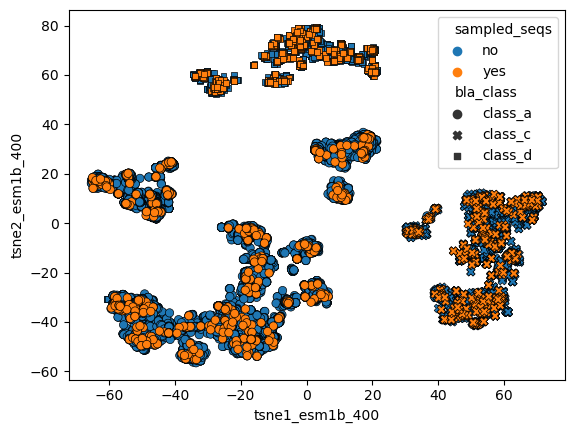

In [4]:
sbl["sampled_seqs"] = np.where(sbl.seq_id.isin(rand_sbl.seq_id), "yes", "no")

sns.scatterplot(sbl.sort_values("sampled_seqs"), x = "tsne1_esm1b_400", y = "tsne2_esm1b_400", 
                style="bla_class", hue = "sampled_seqs", edgecolor = "Black")

<Axes: xlabel='tsne1_esm1b_400', ylabel='tsne2_esm1b_400'>

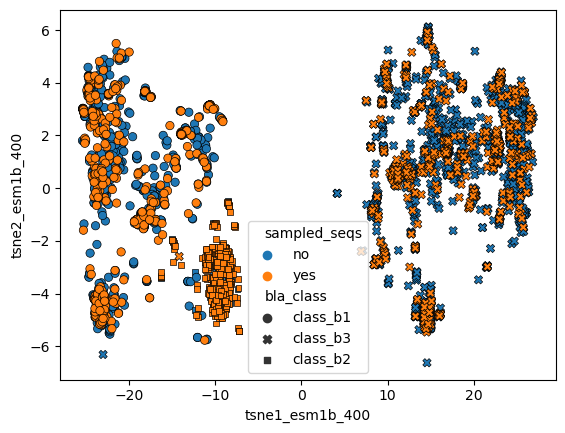

In [5]:
mbl["sampled_seqs"] = np.where(mbl.seq_id.isin(rand_mbl.seq_id), "yes", "no")

sns.scatterplot(mbl.sort_values("sampled_seqs"), x = "tsne1_esm1b_400", y = "tsne2_esm1b_400", 
                style="bla_class",hue = "sampled_seqs", edgecolor = "Black")

<Axes: xlabel='tsne1_esm1b_400', ylabel='tsne2_esm1b_400'>

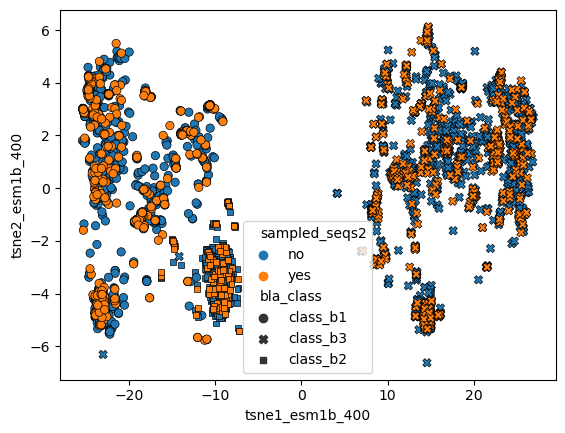

In [6]:
mbl["sampled_seqs2"] = np.where(mbl.seq_id.isin(rand_mbl2.seq_id), "yes", "no")

sns.scatterplot( mbl.sort_values("sampled_seqs2"), x = "tsne1_esm1b_400", y = "tsne2_esm1b_400", 
                style="bla_class",hue = "sampled_seqs2", edgecolor = "Black")

# distance graph

In [7]:
# def plot_graph(data, model, metric):
#     distances = np.array([np.array(x) for x in data[model]])
#     distances = distance.cdist(distances, distances, metric)
# 
#     valid_distances = distances[np.triu_indices(distances.shape[0], k=1)]
#     valid_distances = valid_distances[~np.isnan(valid_distances)]
#     mean_dist = np.mean(valid_distances)
#     mean_dist = np.round(mean_dist, 3)
#     
#     plt.figure(figsize=(7,3))
#     plt.hist(valid_distances, bins=20, color='skyblue', edgecolor='black')
#     plt.axvline(x=mean_dist, color='salmon', linestyle='dashed', linewidth=1)
#     plt.title(f"model = {model} | mean dist. = {mean_dist} | metric = {metric}")
#     sns.despine(trim=True, offset=1)
#     plt.show()
#     
#     np.random.seed(37)
#     num_data = 1200
#     num_categories = 3
#     threshold = mean_dist
#     y = [0] * 400 + [1] * 400 + [2] * 400
#     G = nx.Graph()
# 
#     for i in range(num_data):
#         for j in range(i + 1, num_data):
#             if distances[i, j] < threshold:
#                 G.add_edge(i, j)
# 
#     colors = ['salmon', 'palegreen', 'cornflowerblue']
#     node_colors = {}
#     for i in range(num_data):
#         category = y[i]
#         node_colors[i] = colors[category]
# 
#     plt.figure(figsize=(6,6))
#     pos = nx.spring_layout(G)
#     nx.draw(G, pos, node_color=[node_colors[node] for node in G.nodes()], with_labels=False, node_size=50, width=0.1, 
#             edge_color='lightgray', edgecolors='black', linewidths=1)
#     plt.title(f"model = {model} | mean dist. = {mean_dist} | metric = {metric}")
#     plt.show()

In [8]:
def plot_graph(data, model, metric):
    distances = np.array([np.array(x) for x in data[model]])
    distances = distance.cdist(distances, distances, metric)

    valid_distances = distances[np.triu_indices(distances.shape[0], k=1)]
    valid_distances = valid_distances[~np.isnan(valid_distances)]
    mean_dist = np.mean(valid_distances)
    mean_dist = np.round(mean_dist, 3)

    np.random.seed(37)
    num_data = 1200
    num_categories = 3
    threshold = mean_dist
    y = [0] * 400 + [1] * 400 + [2] * 400
    G = nx.Graph()

    for i in range(num_data):
        for j in range(i + 1, num_data):
            if distances[i, j] < threshold:
                G.add_edge(i, j)

    colors = ['salmon', 'palegreen', 'cornflowerblue']
    node_colors = {}
    for i in range(num_data):
        category = y[i]
        node_colors[i] = colors[category]

    mosaic = """
        A
        B
        B
    """

    ax = plt.figure(figsize=(6,8), constrained_layout = True).subplot_mosaic(mosaic)
    

    ax['A'].hist(valid_distances, bins=20, color='skyblue', edgecolor='black')
    ax['A'].axvline(x=mean_dist, color='salmon', linestyle='dashed', linewidth=2)
    ax['A'].set_title(f"model = {model}\n mean dist. = {mean_dist}\n metric = {metric}")
    sns.despine(trim=True, offset=1,ax=ax['A'])

    pos = nx.spring_layout(G)
    nx.draw(G, pos, ax=ax['B'], node_color=[node_colors[node] for node in G.nodes()], with_labels=False, node_size=50, width=0.1,
            edge_color='lightgray', edgecolors='black', linewidths=1)
    #ax['B'].set_title(f"model = {model} | mean dist. = {mean_dist} | metric = {metric}")

    plt.show()

In [9]:
models = ['esm1b', 'esm2_650m', 'esm2_3b', 'carp', 't5xlu50']

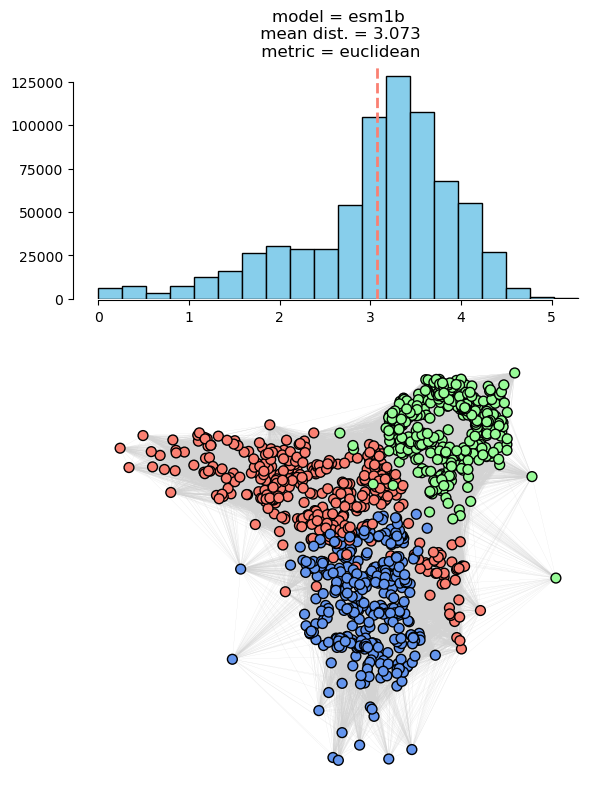

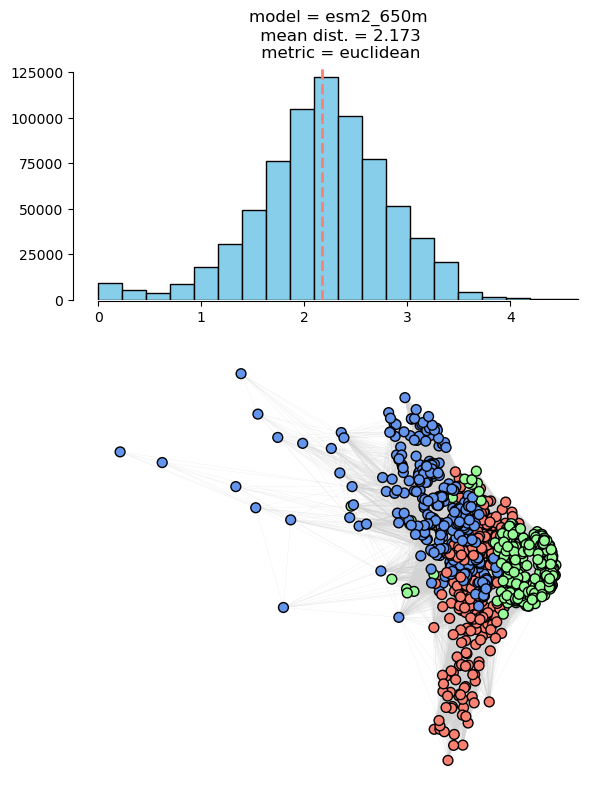

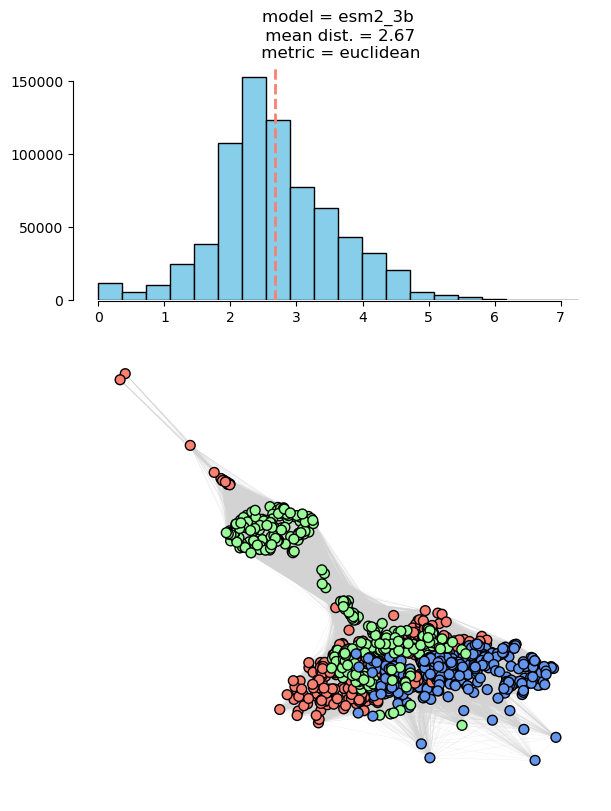

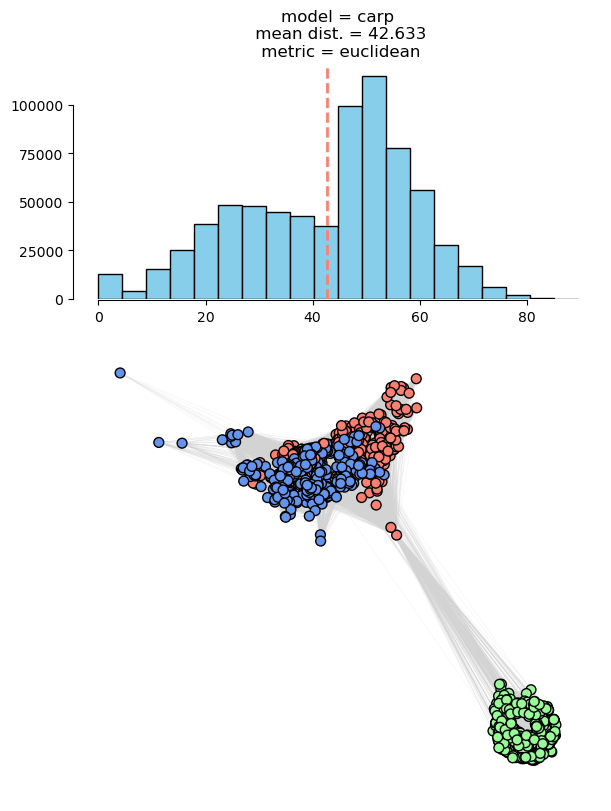

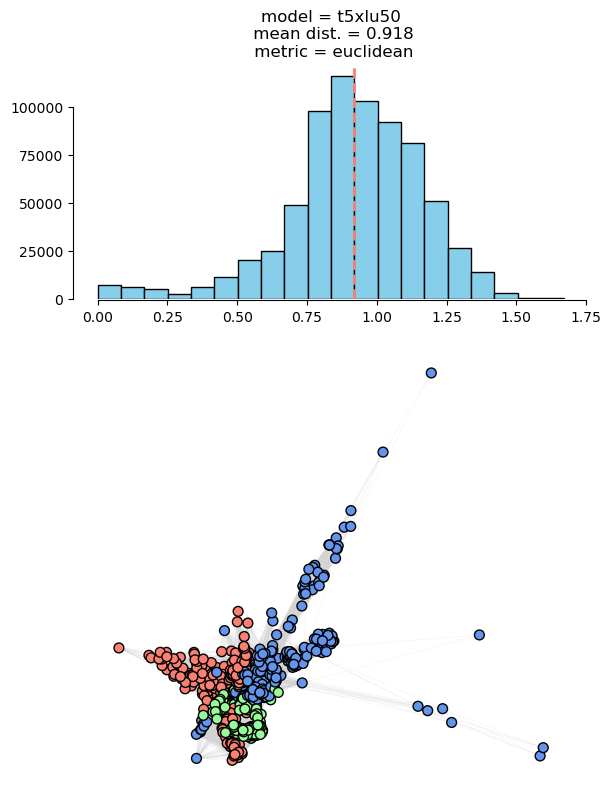

In [10]:
for model in models:
    plot_graph(rand_sbl, model, "euclidean")

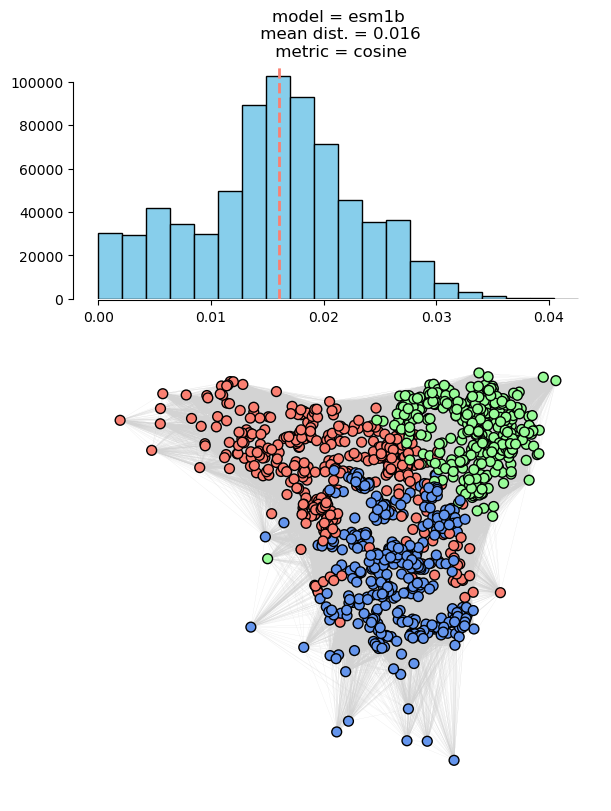

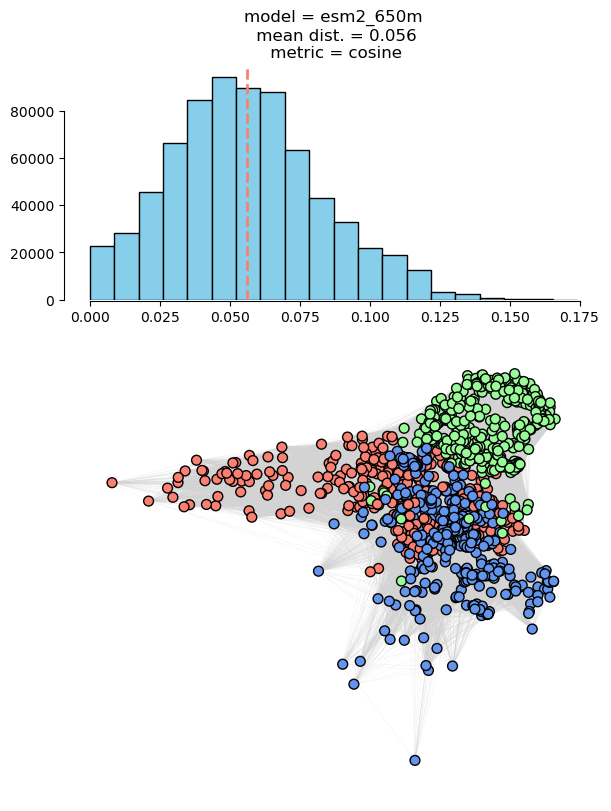

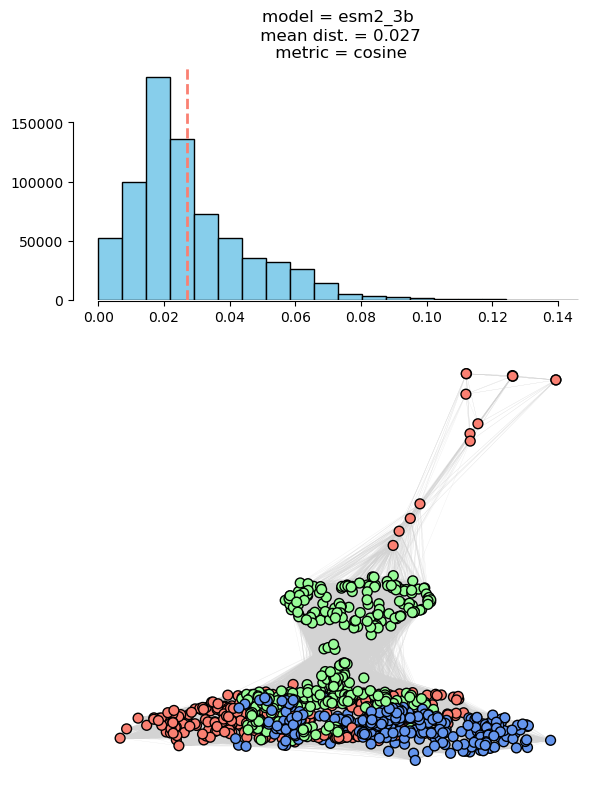

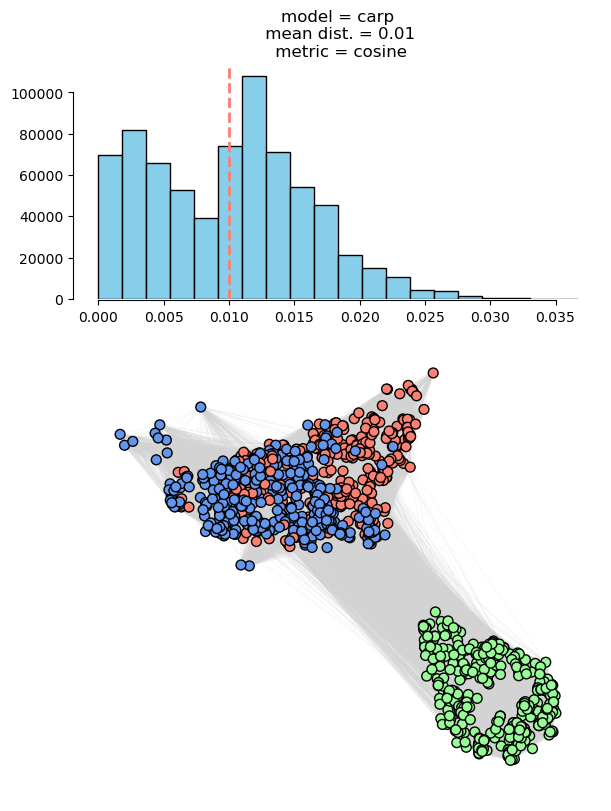

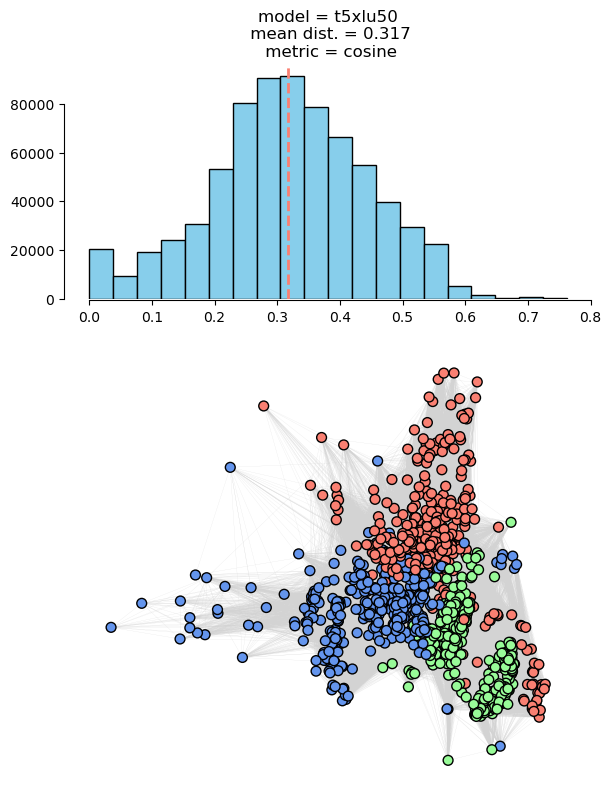

In [11]:
for model in models:
    plot_graph(rand_sbl, model, "cosine")

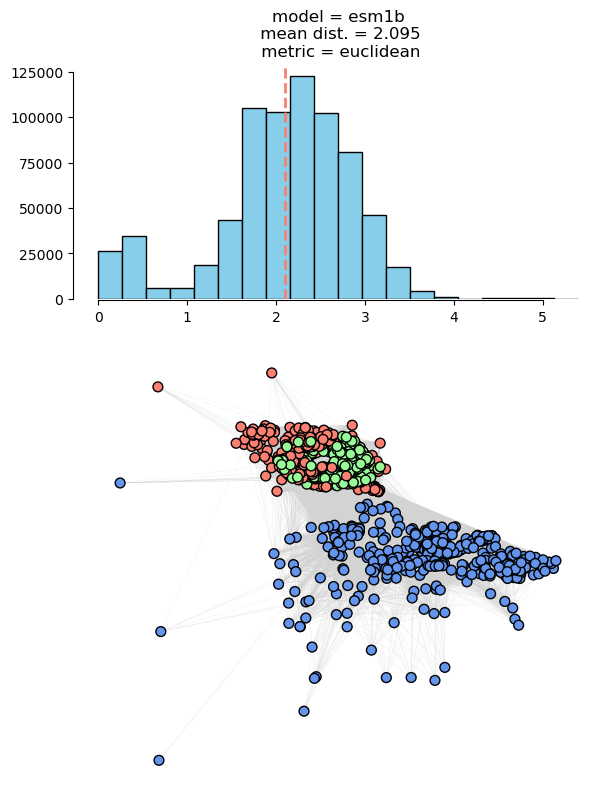

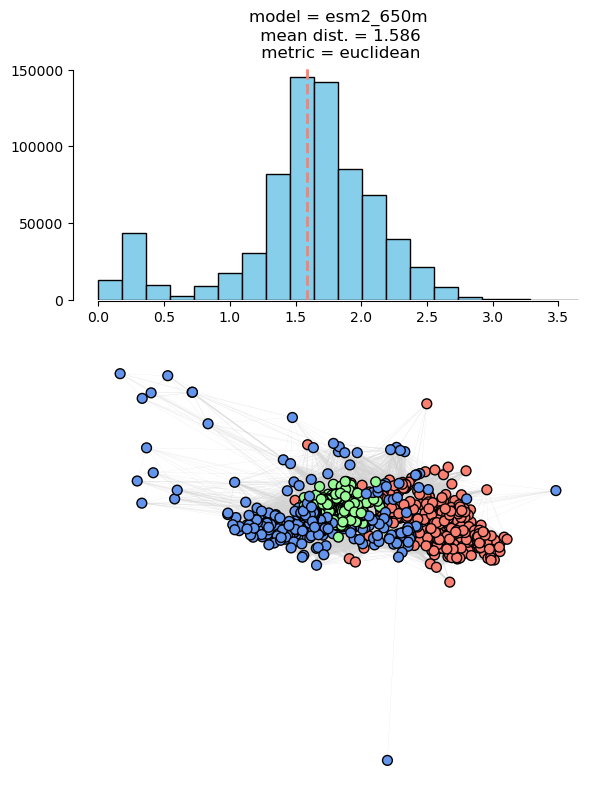

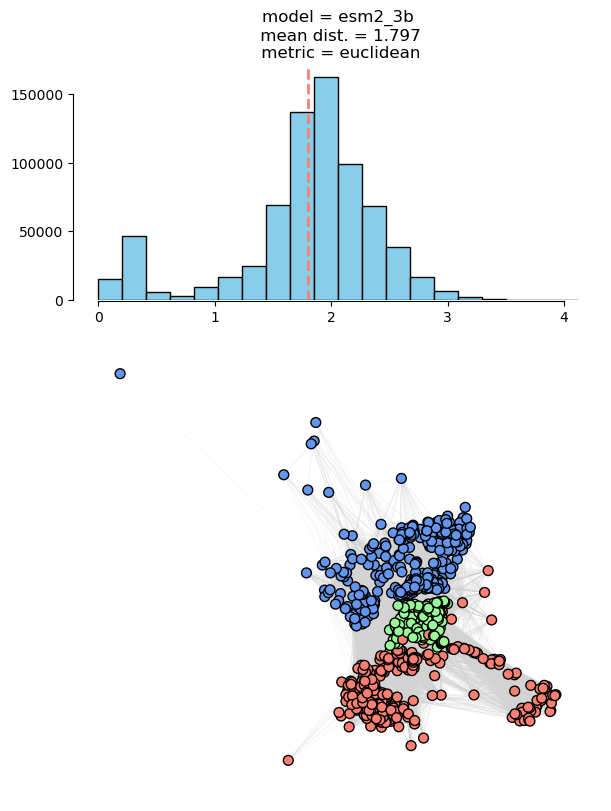

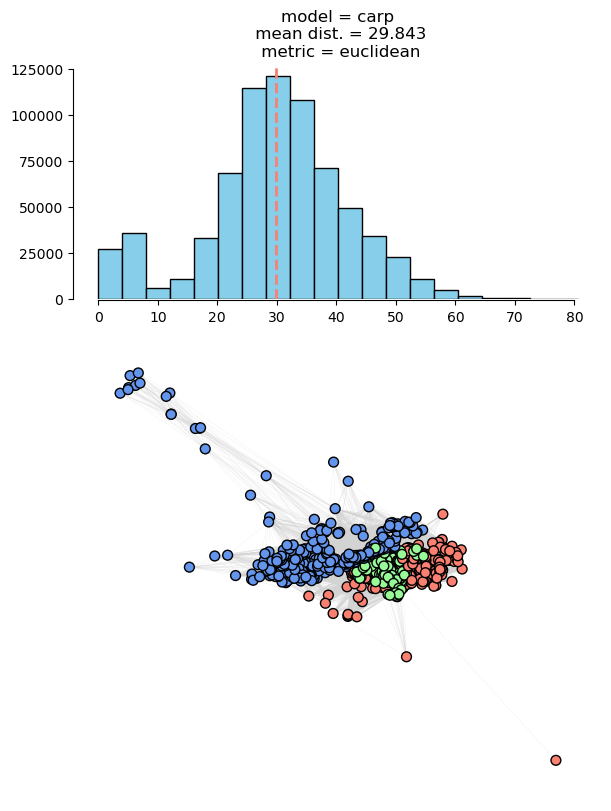

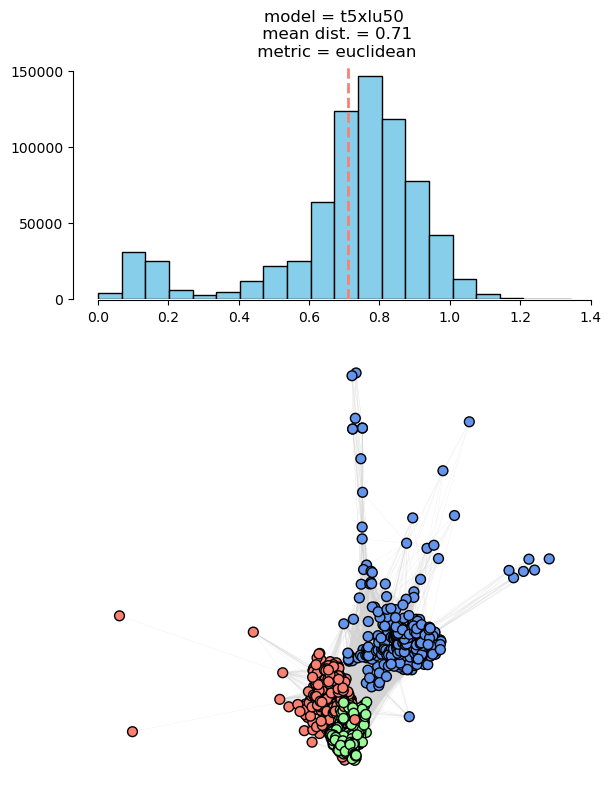

In [12]:
for model in models:
    plot_graph(rand_mbl, model, "euclidean")

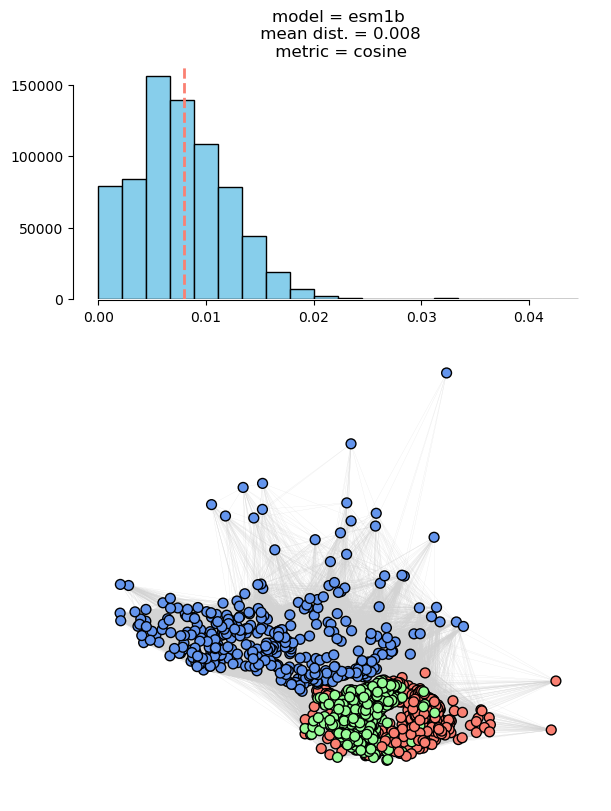

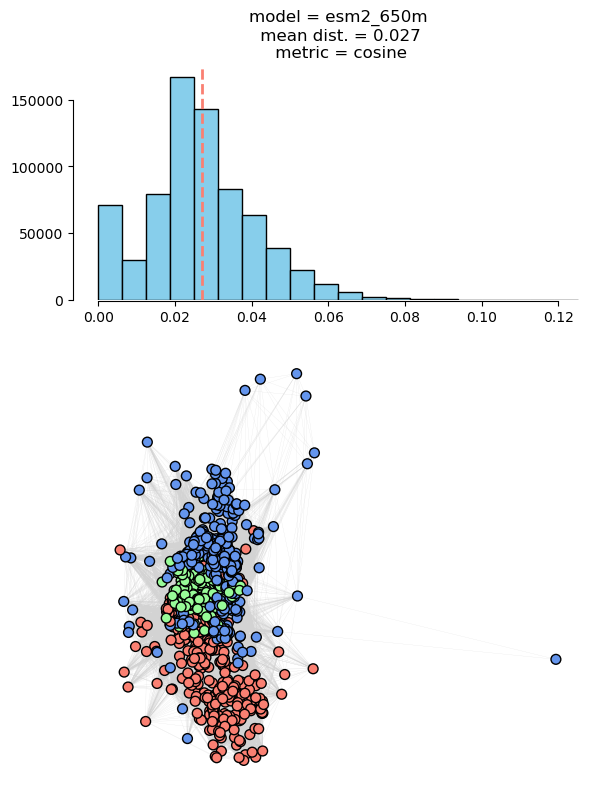

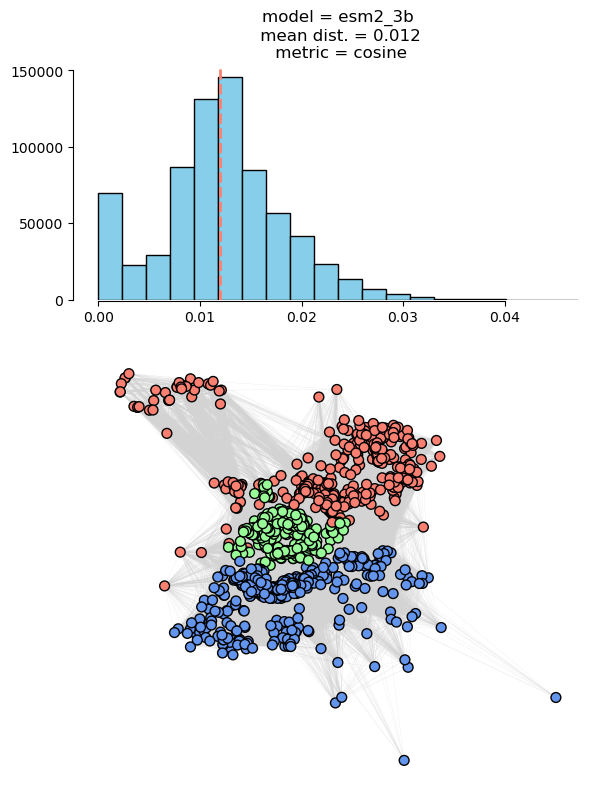

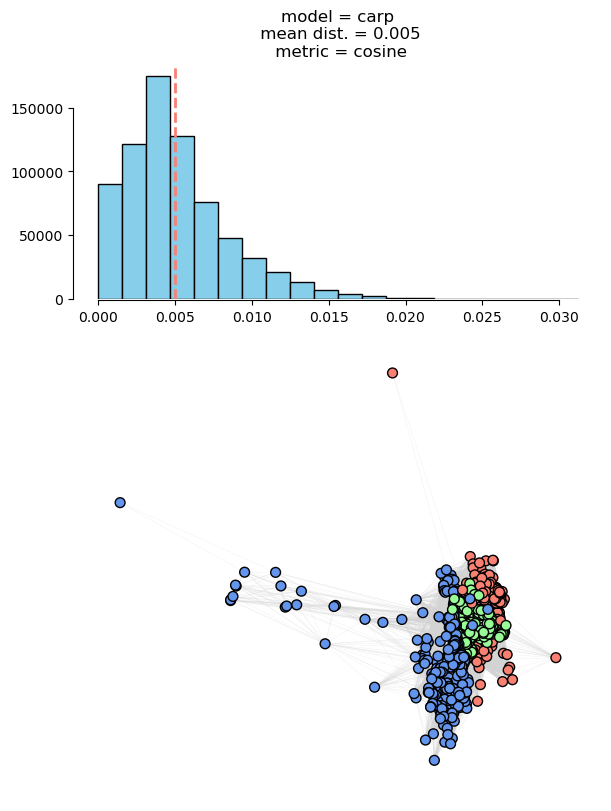

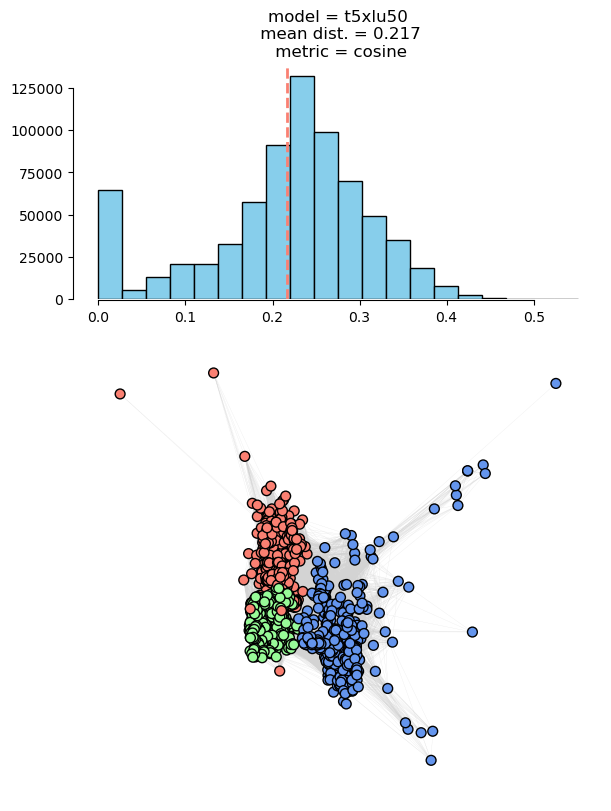

In [13]:
for model in models:
    plot_graph(rand_mbl, model, "cosine")

# distance heatmap

In [14]:
# create a plot fx
def plot_distance(df, model, name):
    
    # select the protein language model
    embeddings =  np.array([np.array(x) for x in df[model]])
    
    # compute pairwise distances and cosine sim
    euclidean_distance = distance.cdist(embeddings, embeddings, "euclidean")
    cosine_distance    = distance.cdist(embeddings, embeddings, "cosine")
    cosine_similarity  = pairwise.cosine_similarity(embeddings, embeddings)
    
    # save it as a dict
    distances = {
        "Euclidean distance":euclidean_distance, 
        "Cosine similarity":cosine_similarity,
        "Cosine distance":cosine_distance
    }

    # create a panel
    fig, axs = plt.subplots(1, 3, figsize=(16, 5))

    # plot the data 
    for i, (key, value) in enumerate(distances.items()):
        
        # convert the data to a df and plot it as a heatmap
        df_dist = pd.DataFrame(value, columns = df["bla_class"].tolist())
        sns.heatmap(df_dist, cmap = "cividis", yticklabels = df["bla_class"].to_list(), 
                    ax = axs[i])
        axs[i].locator_params(nbins=15)
        axs[i].set_title(f"{model}\n {key} | {name}", size = 15)
    
    # adjust the layout
    plt.tight_layout()
    plt.show()

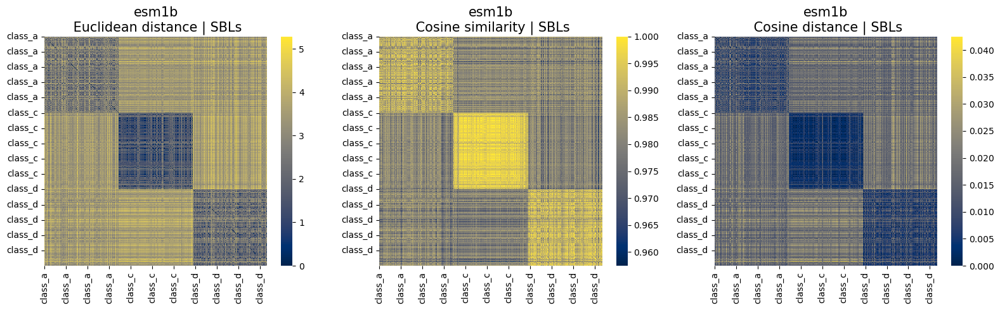

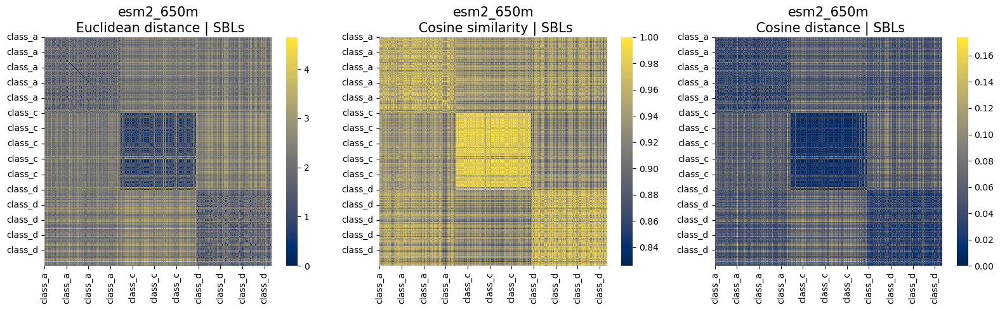

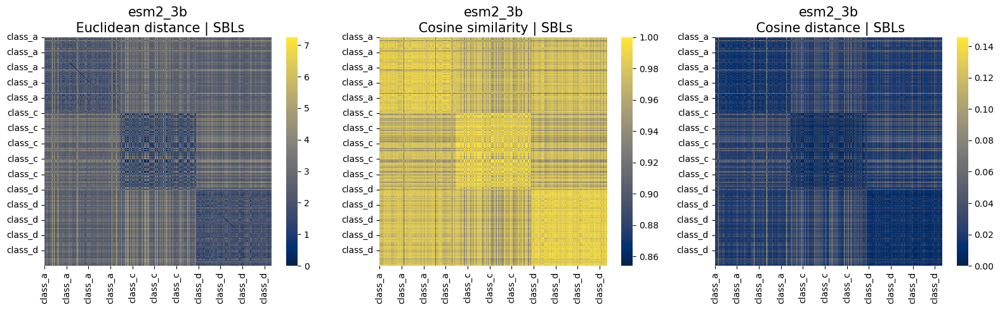

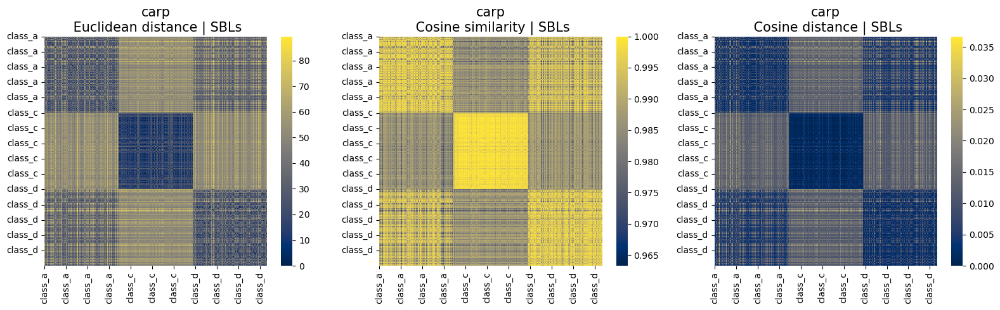

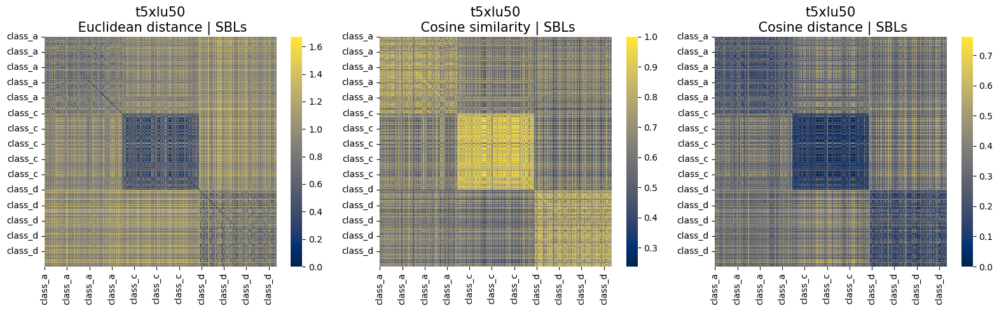

In [15]:
for model in models:
    plot_distance(rand_sbl, model, "SBLs")

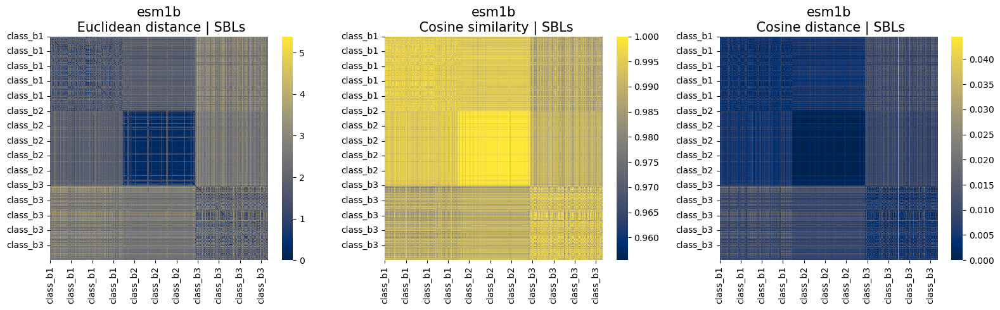

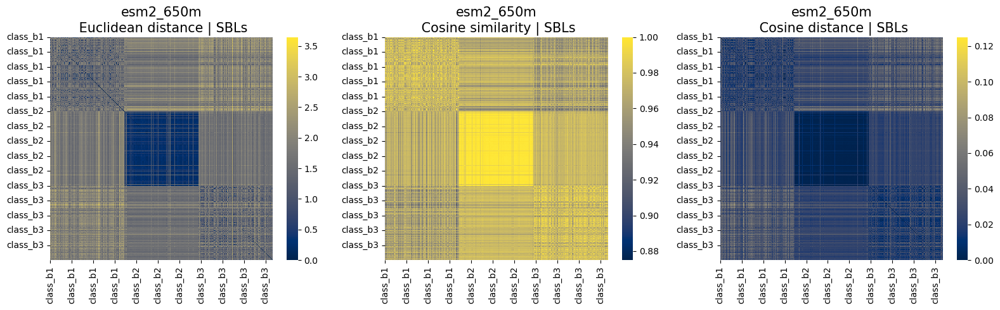

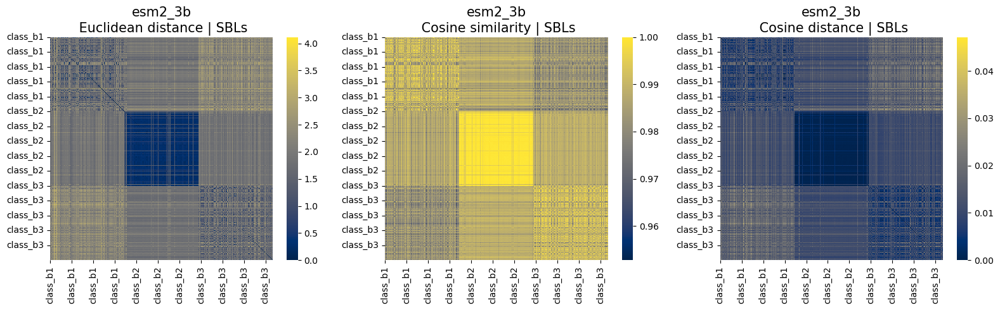

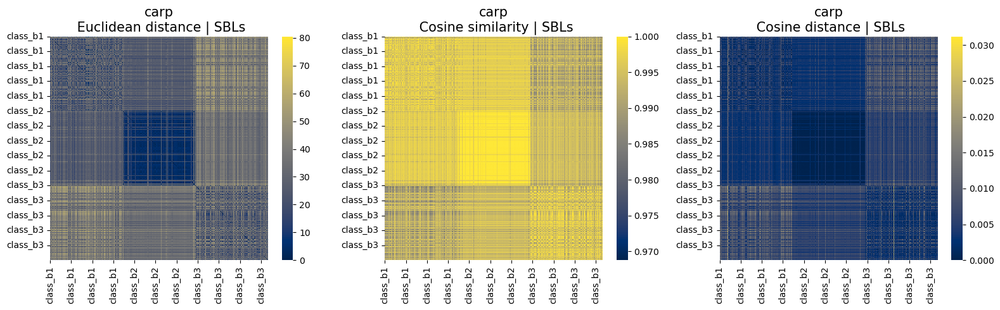

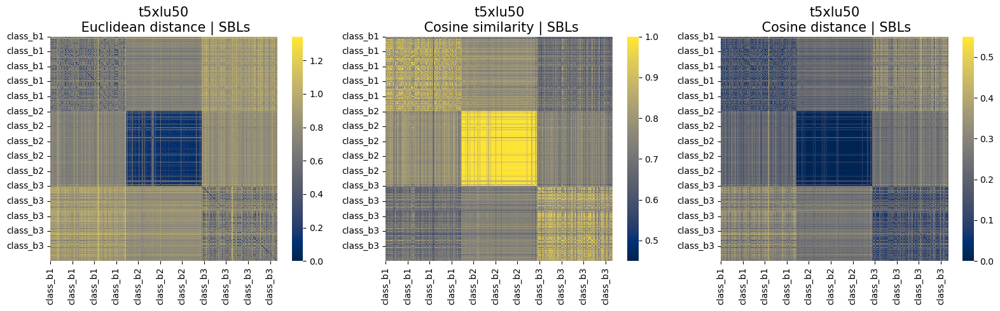

In [16]:
for model in models:
    plot_distance(rand_mbl, model, "SBLs")

# kmeans

In [17]:
rand_sbl["bla_class_merged"] = rand_sbl['bla_class'].apply(lambda x: 'class_ad' if x in ['class_a', 'class_d'] else 'class_c')
rand_sbl["bla_class_merged"].value_counts()

bla_class_merged
class_ad    800
class_c     400
Name: count, dtype: int64

In [18]:
rand_mbl["bla_class_merged"] = rand_mbl['bla_class'].apply(lambda x: 'MB' if x in ['class_b1', 'class_b2'] else 'ME')
rand_mbl["bla_class_merged"].value_counts()

bla_class_merged
MB    800
ME    400
Name: count, dtype: int64

In [19]:
def do_kmeans(data, model, true_label, k, x, y):
    
    # get the embeddings
    embeddings = np.array([np.array(x) for x in data[model]])
    
    # kMeans
    kmeans = KMeans(n_clusters=k, random_state=37, max_iter=1500)
    clusters = kmeans.fit_predict(embeddings)
    
    # get ari
    true_labels = data[true_label].astype(str)
    ari = adjusted_rand_score(true_labels, clusters)
    ari = np.round(ari, 3)

    # add cols
    data["clusters"] = clusters
    data["clusters"] = clusters
    # plot
    plt.figure(figsize=(5,4))
    ax=sns.scatterplot(data=data, x=x, y=y, hue=clusters, style=true_labels, palette="tab10",edgecolor="k", alpha=0.2, s=150)
    plt.title(f"{model} | k = {k}| ARI = {ari}")
    plt.legend(frameon=True, fontsize=8, ncol=2)
    ax.grid(alpha=0.4, linestyle="--")
    ax.set_frame_on(False)
    ax.set_yticklabels([])
    ax.set_xticklabels([])
    ax.set_ylabel("")
    ax.set_xlabel("")
    ax.tick_params(axis='both', colors='white')
    plt.show()
    
    return ari

In [20]:
models

['esm1b', 'esm2_650m', 'esm2_3b', 'carp', 't5xlu50']

/home/gama/anaconda3/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


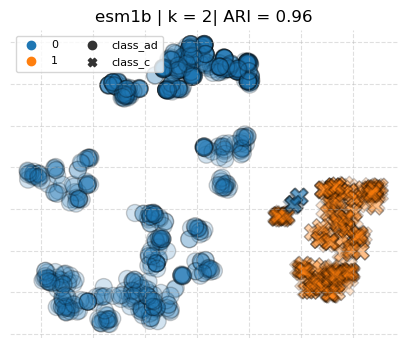

/home/gama/anaconda3/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


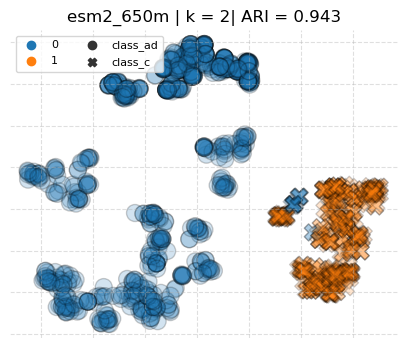

/home/gama/anaconda3/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


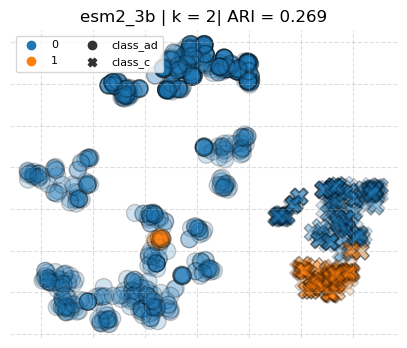

/home/gama/anaconda3/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


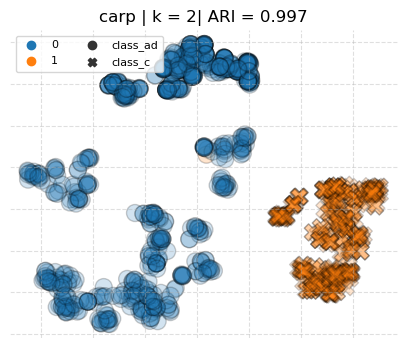

/home/gama/anaconda3/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


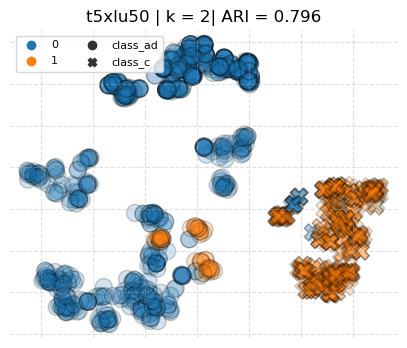

In [21]:
x="tsne1_esm1b_400"
y="tsne2_esm1b_400"
label="bla_class_merged"

sbl_esm1b     = do_kmeans(data=rand_sbl, model="esm1b",     true_label=label, k=2, x=x, y=y)
sbl_esm2_650m = do_kmeans(data=rand_sbl, model="esm2_650m", true_label=label, k=2, x=x, y=y)
sbl_esm2_3b   = do_kmeans(data=rand_sbl, model="esm2_3b",   true_label=label, k=2, x=x, y=y)
sbl_carp      = do_kmeans(data=rand_sbl, model="carp",      true_label=label, k=2, x=x, y=y)
sbl_t5xlu50   = do_kmeans(data=rand_sbl, model="t5xlu50",   true_label=label, k=2, x=x, y=y)

/home/gama/anaconda3/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


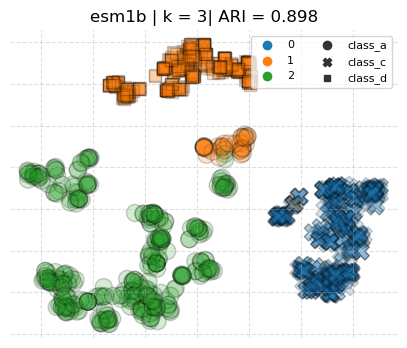

/home/gama/anaconda3/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


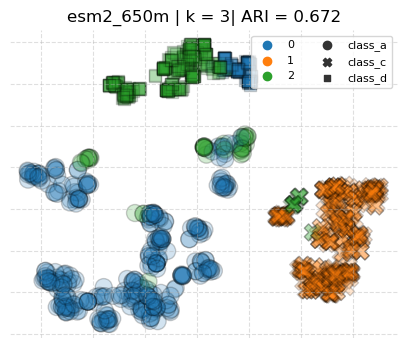

/home/gama/anaconda3/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


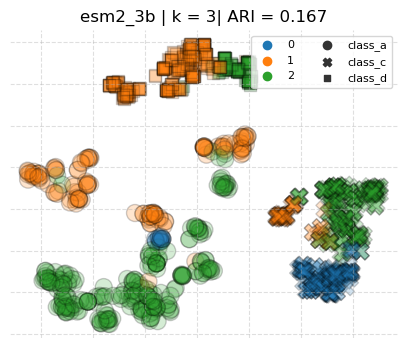

/home/gama/anaconda3/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


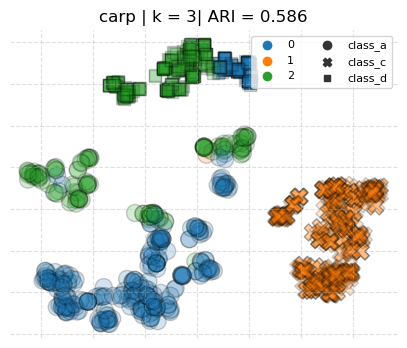

/home/gama/anaconda3/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


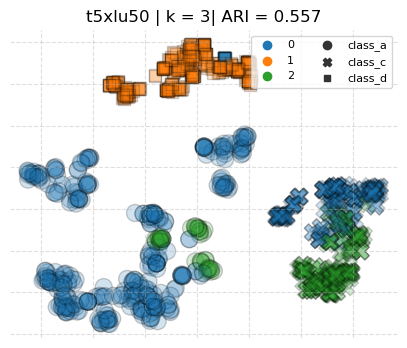

In [22]:
label="bla_class"

sbl_k3_esm1b     = do_kmeans(data=rand_sbl, model="esm1b",     true_label=label, k=3, x=x, y=y)
sbl_k3_esm2_650m = do_kmeans(data=rand_sbl, model="esm2_650m", true_label=label, k=3, x=x, y=y)
sbl_k3_esm2_3b   = do_kmeans(data=rand_sbl, model="esm2_3b",   true_label=label, k=3, x=x, y=y)
sbl_k3_carp      = do_kmeans(data=rand_sbl, model="carp",      true_label=label, k=3, x=x, y=y)
sbl_k3_t5xlu50   = do_kmeans(data=rand_sbl, model="t5xlu50",   true_label=label, k=3, x=x, y=y)

/home/gama/anaconda3/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


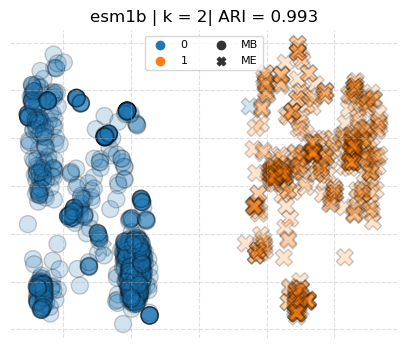

/home/gama/anaconda3/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


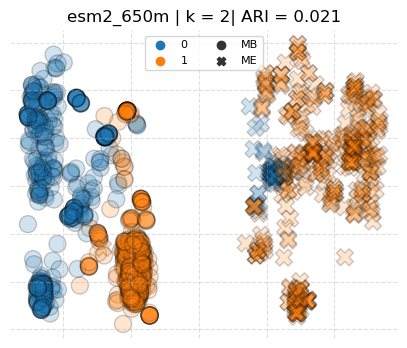

/home/gama/anaconda3/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


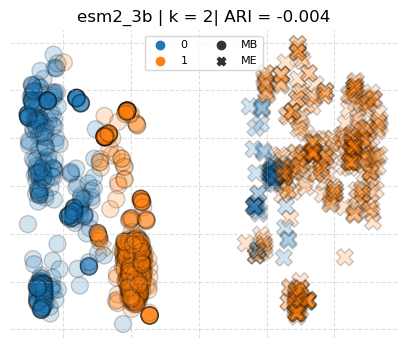

/home/gama/anaconda3/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


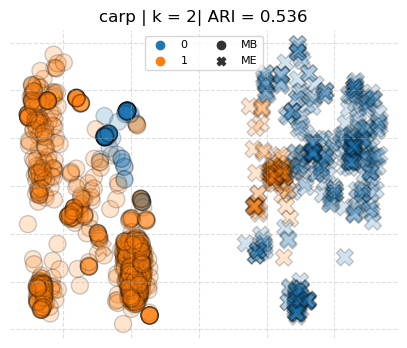

/home/gama/anaconda3/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


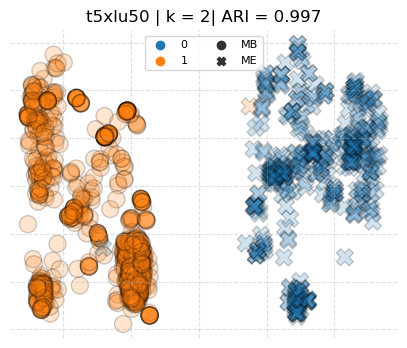

In [23]:
label="bla_class_merged"

mbl_esm1b     = do_kmeans(data=rand_mbl, model="esm1b",     true_label=label, k=2, x=x, y=y)
mbl_esm2_650m = do_kmeans(data=rand_mbl, model="esm2_650m", true_label=label, k=2, x=x, y=y)
mbl_esm2_3b   = do_kmeans(data=rand_mbl, model="esm2_3b",   true_label=label, k=2, x=x, y=y)
mbl_carp      = do_kmeans(data=rand_mbl, model="carp",      true_label=label, k=2, x=x, y=y)
mbl_t5xlu50   = do_kmeans(data=rand_mbl, model="t5xlu50",   true_label=label, k=2, x=x, y=y)

/home/gama/anaconda3/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


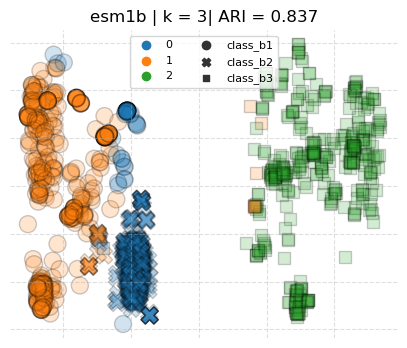

/home/gama/anaconda3/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


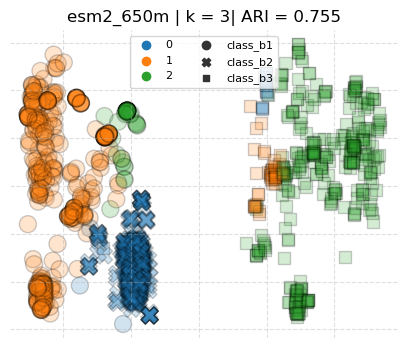

/home/gama/anaconda3/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


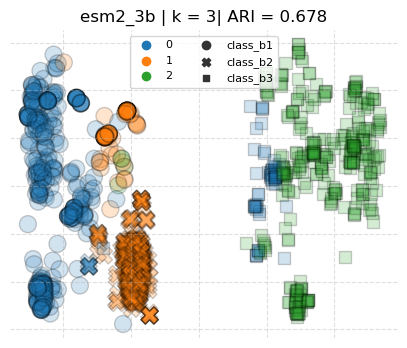

/home/gama/anaconda3/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


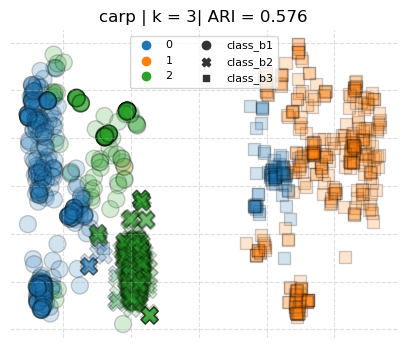

/home/gama/anaconda3/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


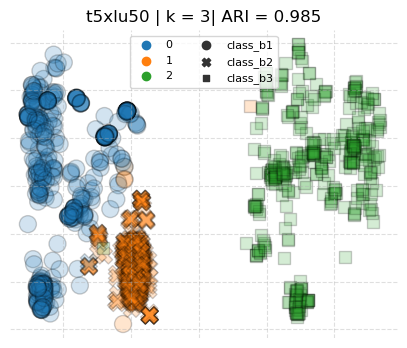

In [24]:
label="bla_class"

mbl_k3_esm1b     = do_kmeans(data=rand_mbl, model="esm1b",     true_label=label, k=3, x=x, y=y)
mbl_k3_esm2_650m = do_kmeans(data=rand_mbl, model="esm2_650m", true_label=label, k=3, x=x, y=y)
mbl_k3_esm2_3b   = do_kmeans(data=rand_mbl, model="esm2_3b",   true_label=label, k=3, x=x, y=y)
mbl_k3_carp      = do_kmeans(data=rand_mbl, model="carp",      true_label=label, k=3, x=x, y=y)
mbl_k3_t5xlu50   = do_kmeans(data=rand_mbl, model="t5xlu50",   true_label=label, k=3, x=x, y=y)

In [25]:
sbl_k3 = [
    sbl_k3_esm1b,
    sbl_k3_esm2_650m,
    sbl_k3_esm2_3b,
    sbl_k3_carp,
    sbl_k3_t5xlu50]

sbl_k2 = [
    sbl_esm1b,
    sbl_esm2_650m,
    sbl_esm2_3b,
    sbl_carp,
    sbl_t5xlu50]

mbl_k3 = [
    mbl_k3_esm1b,
    mbl_k3_esm2_650m,
    mbl_k3_esm2_3b,
    mbl_k3_carp,
    mbl_k3_t5xlu50]

mbl_k2 = [
    mbl_esm1b,
    mbl_esm2_650m,
    mbl_esm2_3b,
    mbl_carp,
    mbl_t5xlu50]

df_kmeans = pd.DataFrame({"model":models, "k3_SBL":sbl_k3, "k2_SBL":sbl_k2, "k3_MBL":mbl_k3, "k2_MBL":mbl_k2})
df_kmeans = df_kmeans.melt(id_vars=["model"])
df_kmeans

,model,variable,value
0,esm1b,k3_SBL,0.898
1,esm2_650m,k3_SBL,0.672
2,esm2_3b,k3_SBL,0.167
3,carp,k3_SBL,0.586
4,t5xlu50,k3_SBL,0.557
5,esm1b,k2_SBL,0.960
6,esm2_650m,k2_SBL,0.943
7,esm2_3b,k2_SBL,0.269
8,carp,k2_SBL,0.997
9,t5xlu50,k2_SBL,0.796


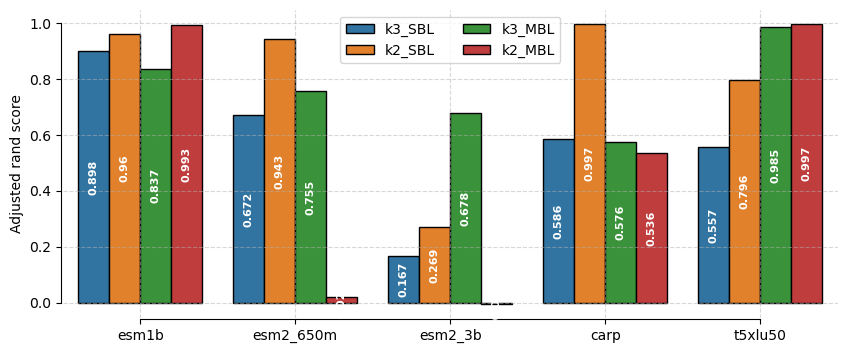

In [26]:
plt.figure(figsize=(10,4))
ax=sns.barplot(df_kmeans, x="model", y="value", hue="variable", palette="tab10", edgecolor="k",)
plt.grid(alpha=0.5, linestyle="--")
plt.ylabel("Adjusted rand score")
plt.xlabel("")
plt.legend(title=False, ncol=2)
for idx in [0,1,2,3]:
    ax.bar_label(ax.containers[idx], rotation=90, label_type="center", color="w",weight='bold', fontsize=8)
sns.despine(trim=True, offset=1)

In [27]:
df_kmeans.groupby('model')['value'].mean().sort_values().round(3)

model
esm2_3b      0.278
esm2_650m    0.598
carp         0.674
t5xlu50      0.834
esm1b        0.922
Name: value, dtype: float64

Text(0.5, 1.0, 'k-means')

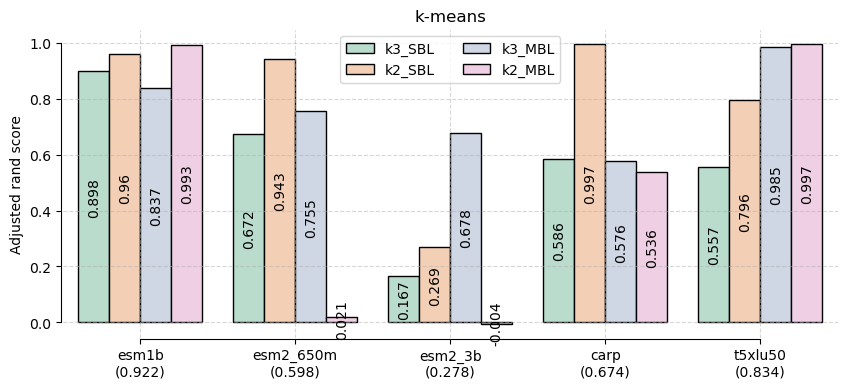

In [28]:
plt.figure(figsize=(10,4))
ax=sns.barplot(df_kmeans, x="model", y="value", hue="variable", palette="Pastel2", edgecolor="k")
plt.grid(alpha=0.5, linestyle="--")
plt.ylabel("Adjusted rand score")
plt.xlabel("")
plt.legend(title=False, ncol=2)
for idx in [0,1,2,3]:
    ax.bar_label(ax.containers[idx], rotation=90, label_type="center", color="k", fontsize=10)
ax.set_xticklabels(["esm1b\n(0.922)","esm2_650m\n(0.598)", "esm2_3b\n(0.278)", "carp\n(0.674)", "t5xlu50\n(0.834)"])
sns.despine(trim=True, offset=1)
plt.title("k-means")

In [29]:
# def do_linkage(data, model, true_label, k, x, y):
#     
#     # get the embeddings
#     embeddings = np.array([np.array(x) for x in data[model]])
#     
#     # linkage
#     Z = linkage(embeddings, method='ward', metric='euclidean')
#     clusters = fcluster(Z, k, criterion='maxclust')
#     
#     # get ari
#     true_labels = data[true_label].astype(str)
#     ari = adjusted_rand_score(true_labels, clusters)
#     ari = np.round(ari, 3)
# 
#     # add cols
#     data["clusters"] = clusters
#     
#     # plot
#     plt.figure(figsize=(5,4))
#     ax=sns.scatterplot(data=data, x=x, y=y, hue=clusters, style=true_labels, palette="tab10",edgecolor="k", alpha=0.2, s=150)
#     plt.title(f"{model} | k = {k}| ARI = {ari}")
#     plt.legend(frameon=True, fontsize=8, ncol=2)
#     ax.grid(alpha=0.4, linestyle="--")
#     ax.set_frame_on(False)
#     ax.set_yticklabels([])
#     ax.set_xticklabels([])
#     ax.set_ylabel("")
#     ax.set_xlabel("")
#     ax.tick_params(axis='both', colors='white')
#     plt.show()
#     
#     return ari

In [30]:
# https://pythonguides.com/python-scipy-fcluster/
def do_linkage(data, model, true_label, k, x, y):
    
    # get the embeddings
    embeddings = np.array([np.array(x) for x in data[model]])
    
    # linkage
    Z = linkage(embeddings, method="ward", metric="euclidean")
    clusters = fcluster(Z, k, criterion="maxclust")
    
    # get ari
    true_labels = data[true_label].astype(str)
    ari = adjusted_rand_score(true_labels, clusters)
    ari = np.round(ari, 3)

    # add cols
    data["clusters"] = clusters
    
    #  scatterp
    plt.figure(figsize=(5,4))
    ax=sns.scatterplot(data=data, x=x, y=y, hue=clusters, style=true_labels, palette="tab10",edgecolor="k", alpha=0.2, s=150)
    plt.title(f"{model} | k = {k}| ARI = {ari}")
    plt.legend(frameon=True, fontsize=8, ncol=2)
    ax.grid(alpha=0.4, linestyle="--")
    ax.set_frame_on(False)
    ax.set_yticklabels([])
    ax.set_xticklabels([])
    ax.set_ylabel("")
    ax.set_xlabel("")
    ax.tick_params(axis='both', colors='white')
    plt.show()
    
    #  dendrogram
    plt.figure(figsize=(12, 4))
    dendrogram(Z, no_labels=False, labels=data.bla_class.tolist())
    plt.title(model)
    plt.xlabel("")
    plt.ylabel("Ward distance")
    labels = plt.gca().get_xticklabels()
    for i, label in enumerate(labels):
        if i % 40 != 0:
            label.set_visible(False)
    plt.xticks(size=10)
    plt.show()
    
    return ari

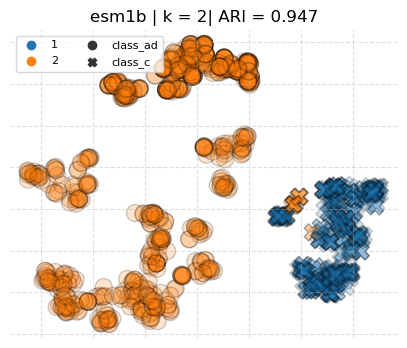

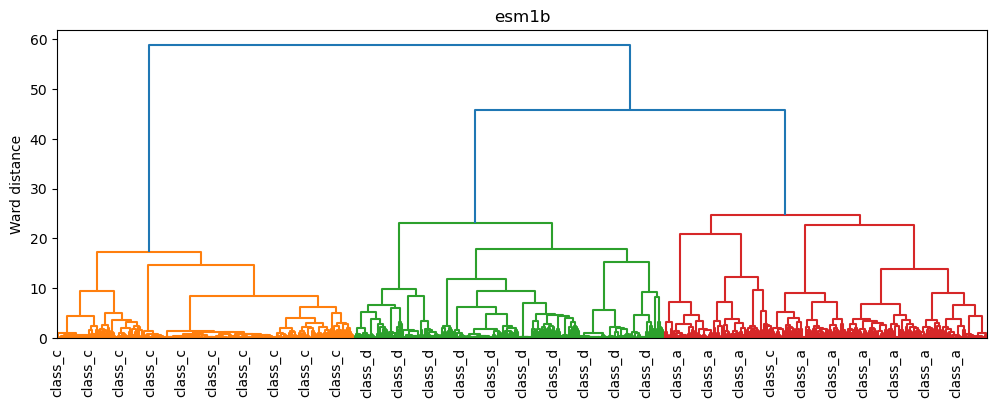

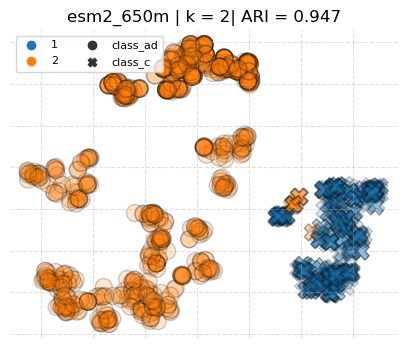

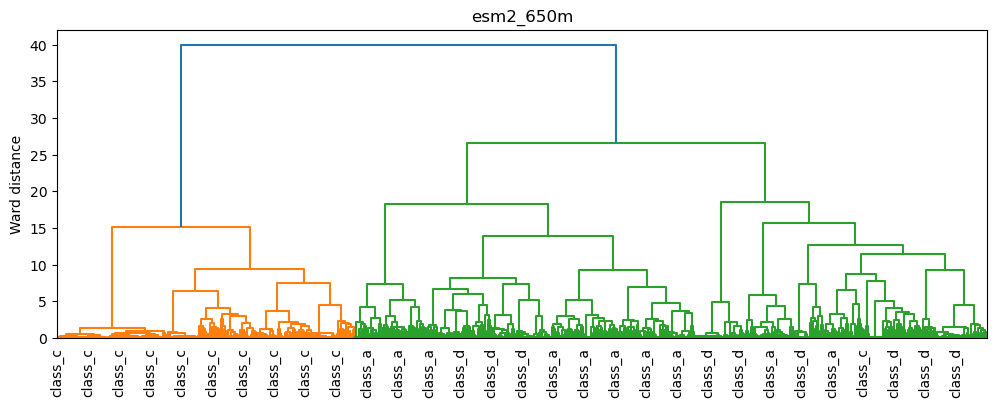

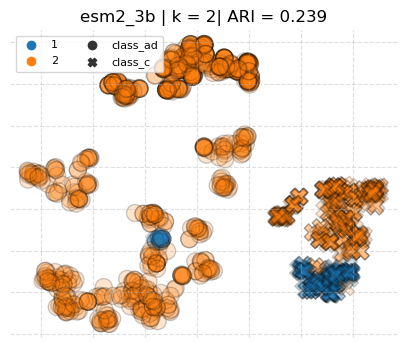

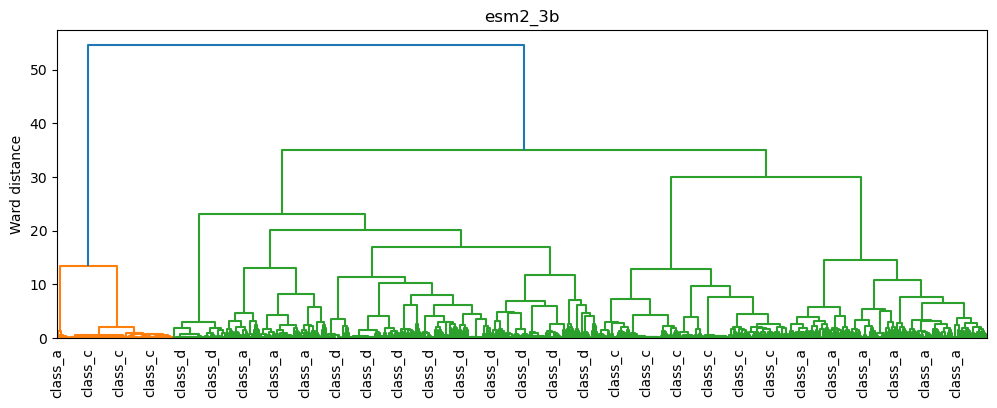

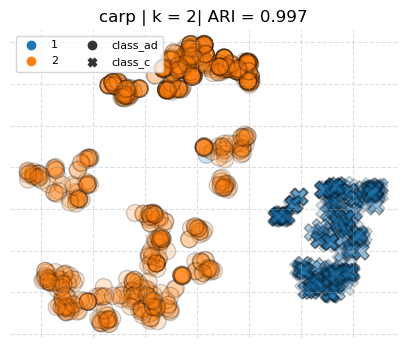

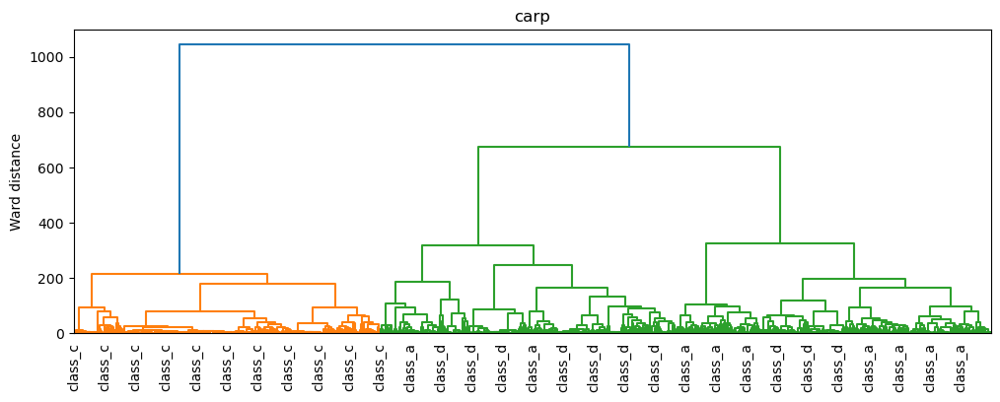

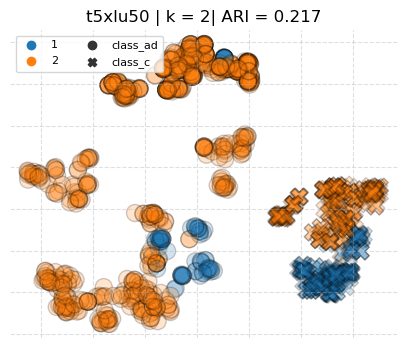

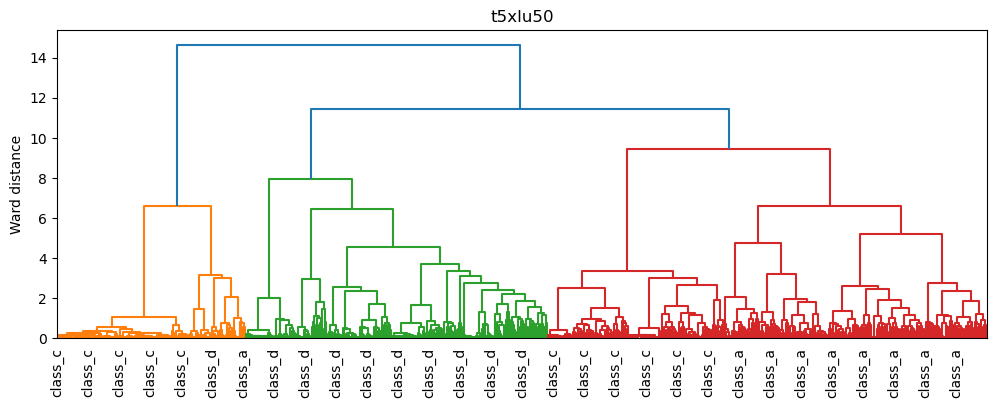

In [31]:
label="bla_class_merged"

link_sbl_esm1b     = do_linkage(data=rand_sbl, model="esm1b",     true_label=label, k=2, x=x, y=y)
link_sbl_esm2_650m = do_linkage(data=rand_sbl, model="esm2_650m", true_label=label, k=2, x=x, y=y)
link_sbl_esm2_3b   = do_linkage(data=rand_sbl, model="esm2_3b",   true_label=label, k=2, x=x, y=y)
link_sbl_carp      = do_linkage(data=rand_sbl, model="carp",      true_label=label, k=2, x=x, y=y)
link_sbl_t5xlu50   = do_linkage(data=rand_sbl, model="t5xlu50",   true_label=label, k=2, x=x, y=y)

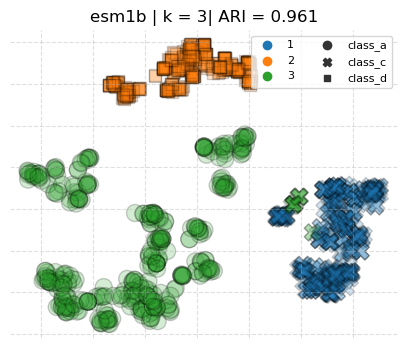

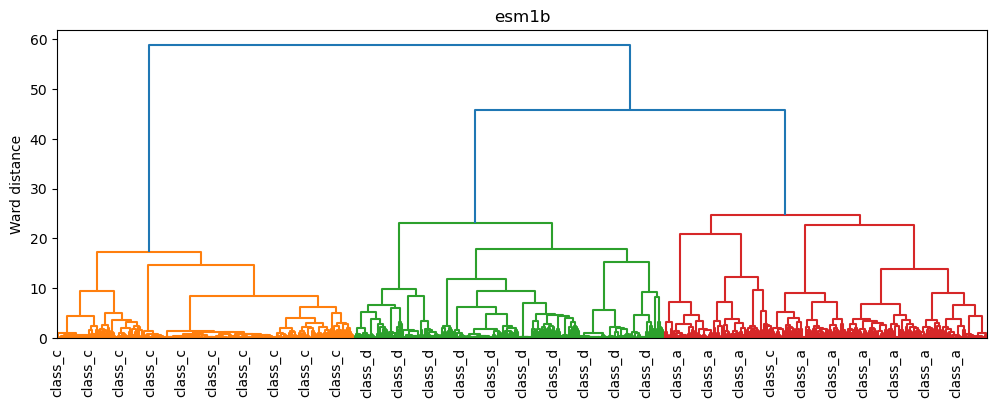

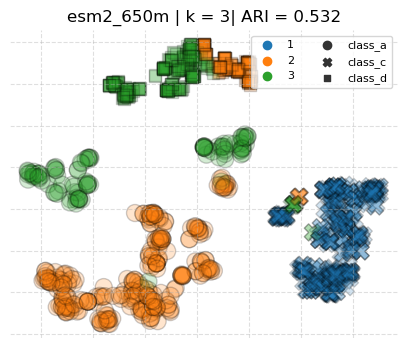

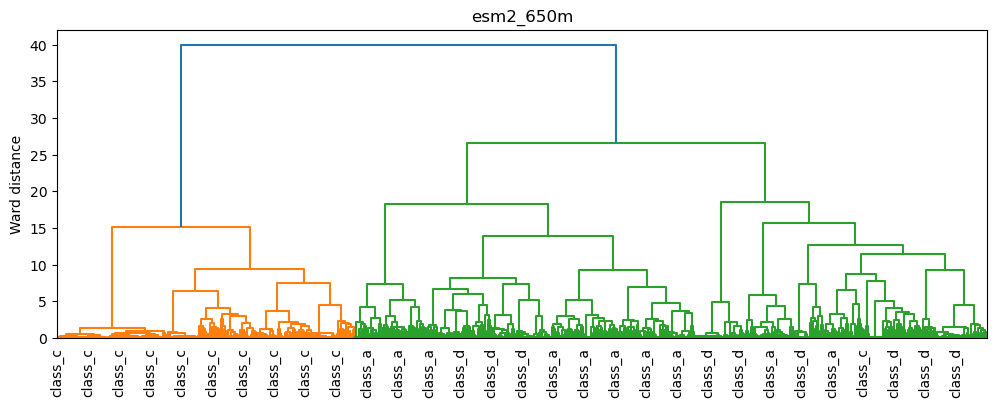

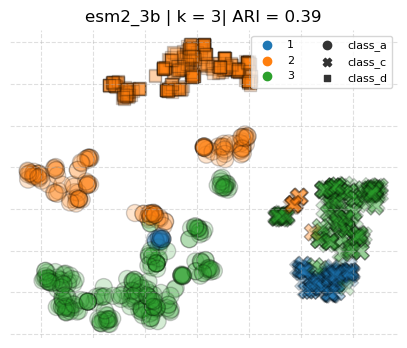

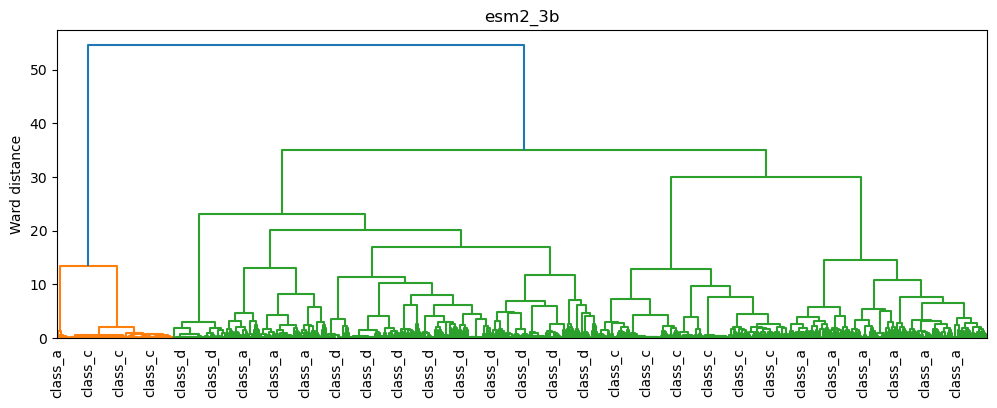

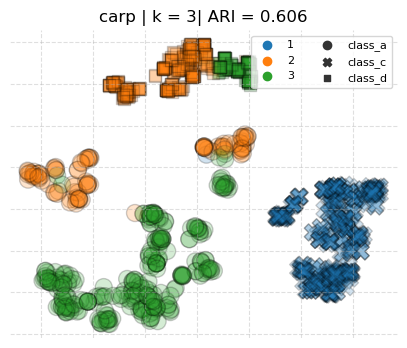

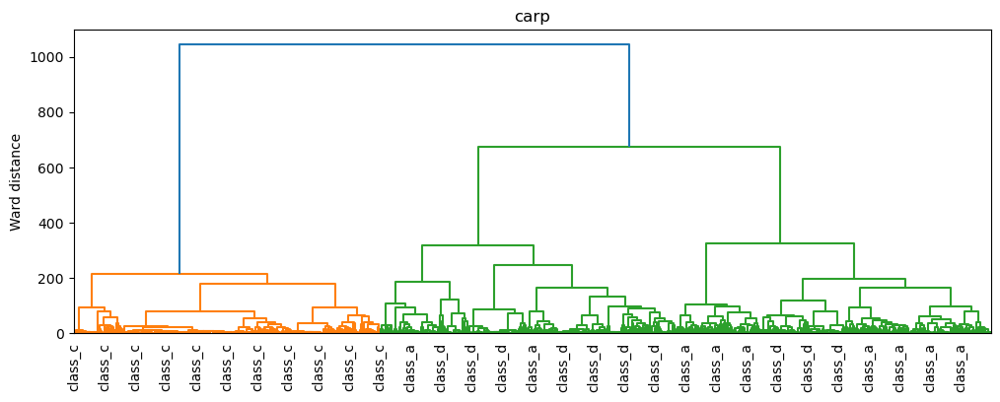

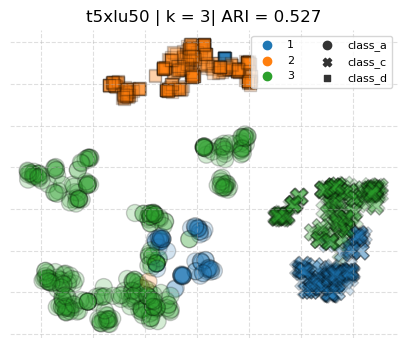

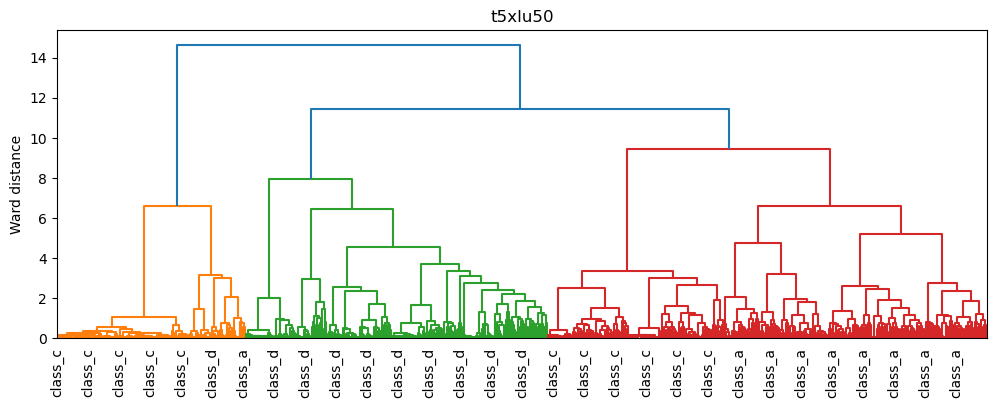

In [32]:
label="bla_class"
link_sbl_k3_esm1b     = do_linkage(data=rand_sbl, model="esm1b",     true_label=label, k=3, x=x, y=y)
link_sbl_k3_esm2_650m = do_linkage(data=rand_sbl, model="esm2_650m", true_label=label, k=3, x=x, y=y)
link_sbl_k3_esm2_3b   = do_linkage(data=rand_sbl, model="esm2_3b",   true_label=label, k=3, x=x, y=y)
link_sbl_k3_carp      = do_linkage(data=rand_sbl, model="carp",      true_label=label, k=3, x=x, y=y)
link_sbl_k3_t5xlu50   = do_linkage(data=rand_sbl, model="t5xlu50",   true_label=label, k=3, x=x, y=y)

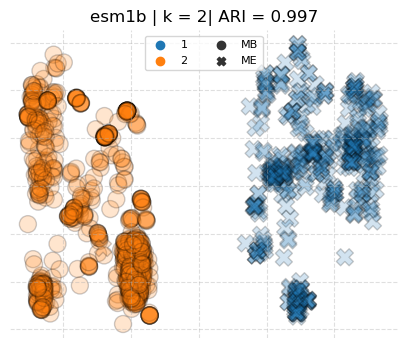

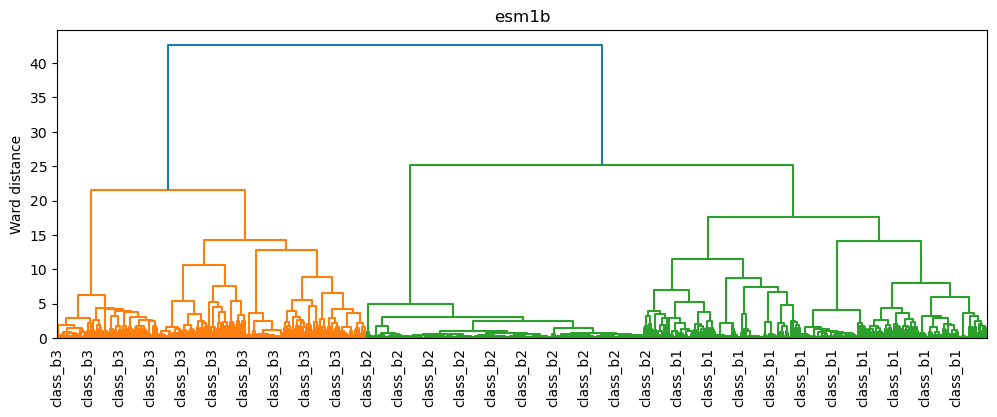

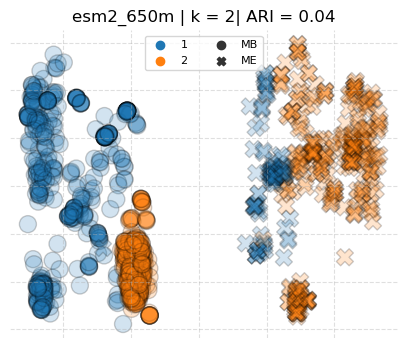

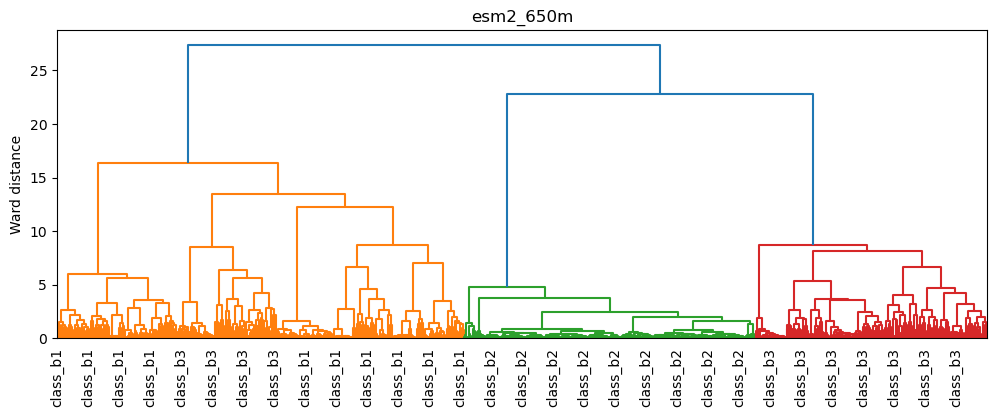

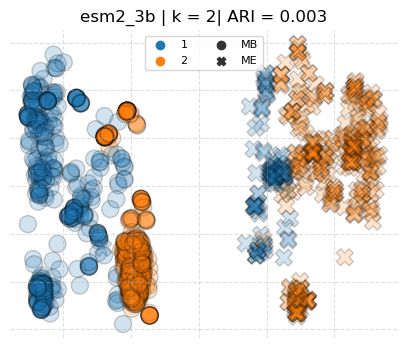

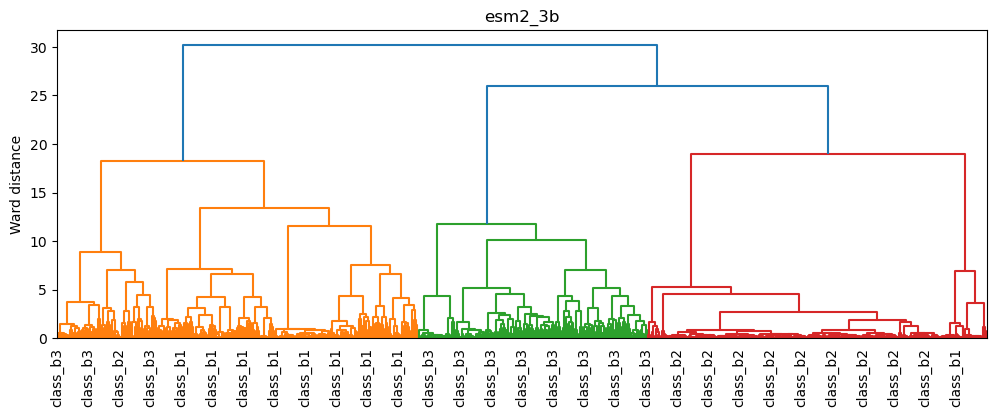

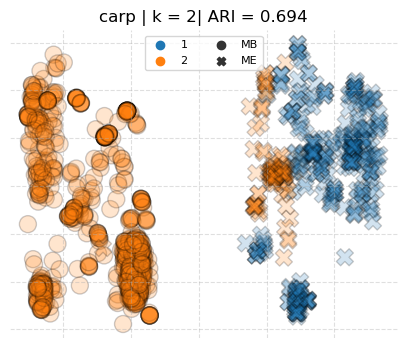

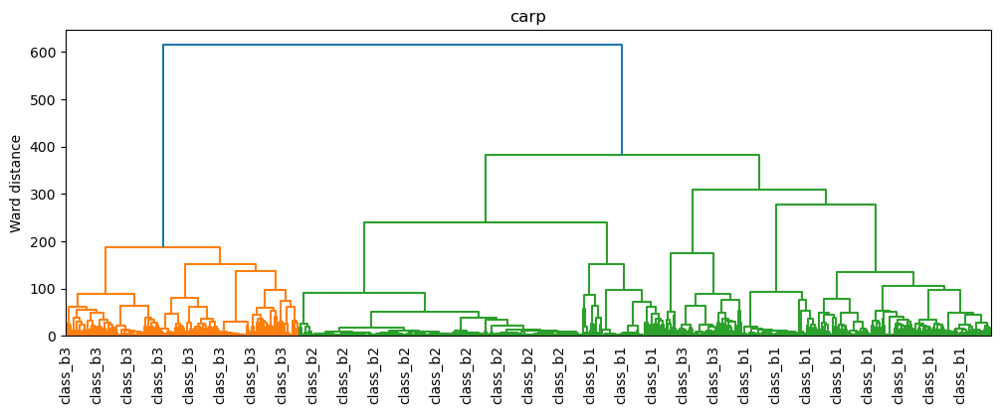

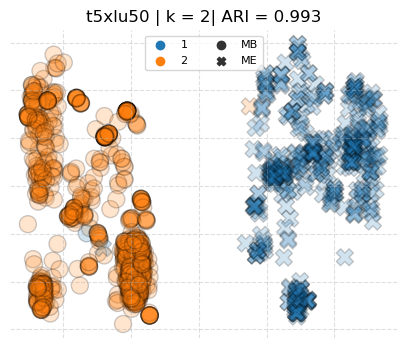

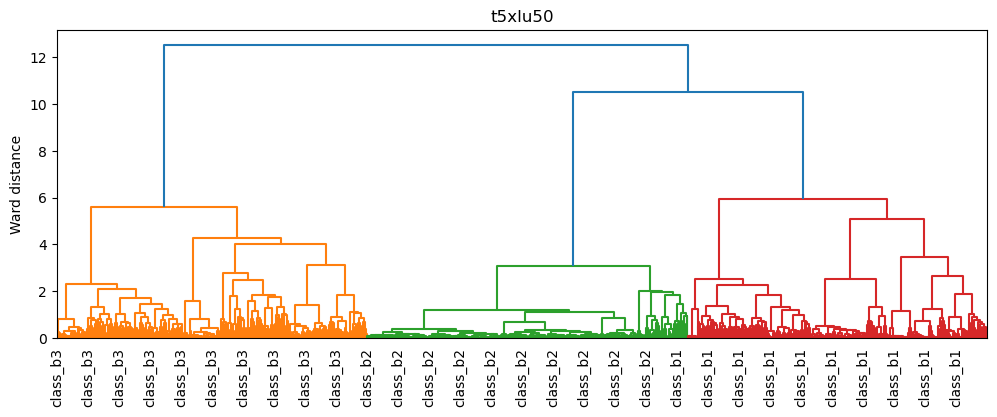

In [33]:
label="bla_class_merged"
link_mbl_esm1b     = do_linkage(data=rand_mbl, model="esm1b",     true_label=label, k=2, x=x, y=y)
link_mbl_esm2_650m = do_linkage(data=rand_mbl, model="esm2_650m", true_label=label, k=2, x=x, y=y)
link_mbl_esm2_3b   = do_linkage(data=rand_mbl, model="esm2_3b",   true_label=label, k=2, x=x, y=y)
link_mbl_carp      = do_linkage(data=rand_mbl, model="carp",      true_label=label, k=2, x=x, y=y)
link_mbl_t5xlu50   = do_linkage(data=rand_mbl, model="t5xlu50",   true_label=label, k=2, x=x, y=y)

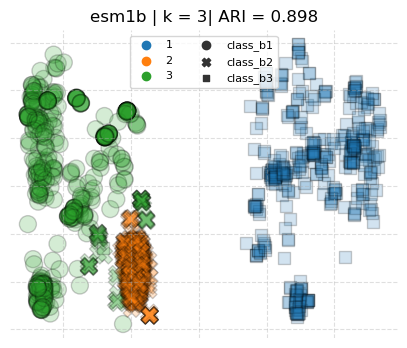

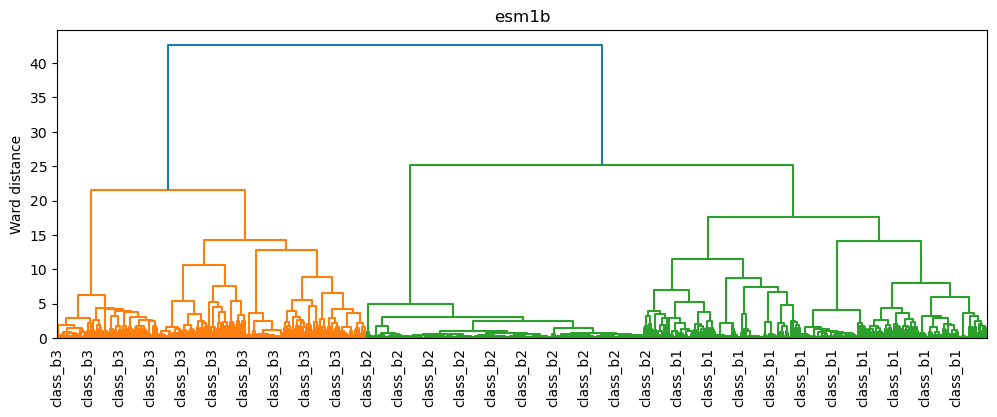

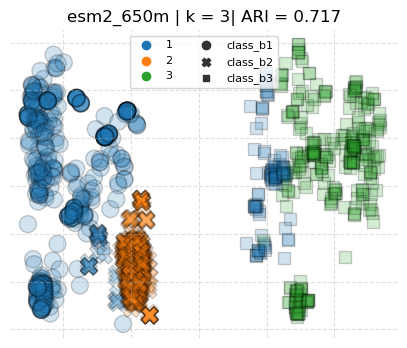

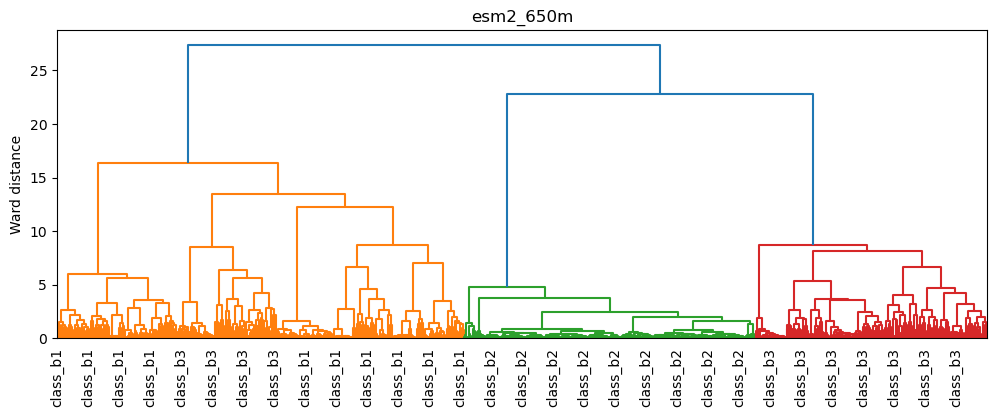

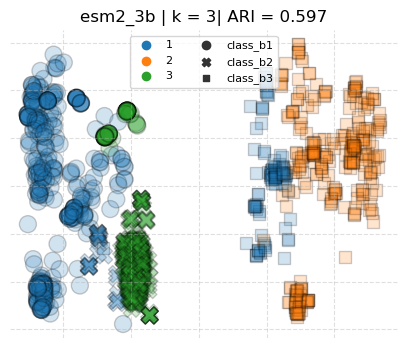

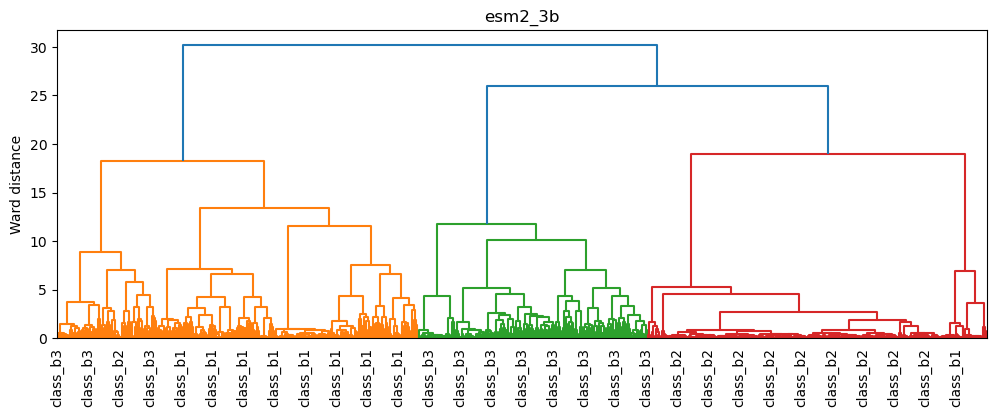

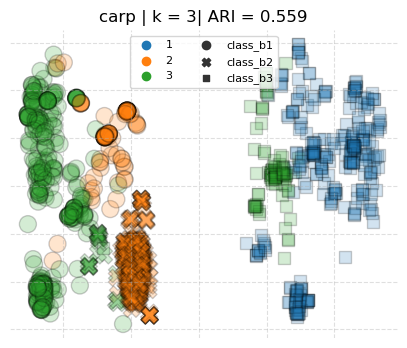

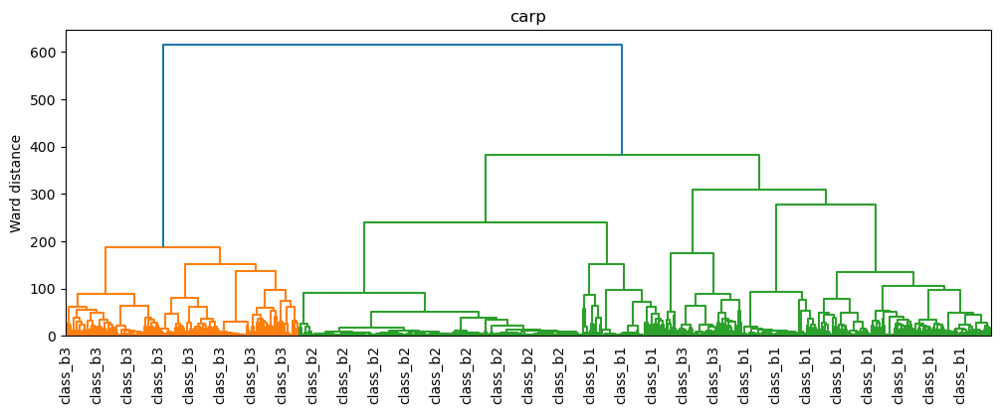

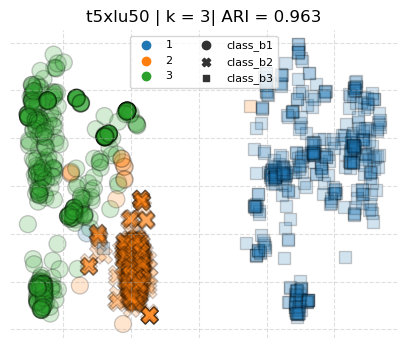

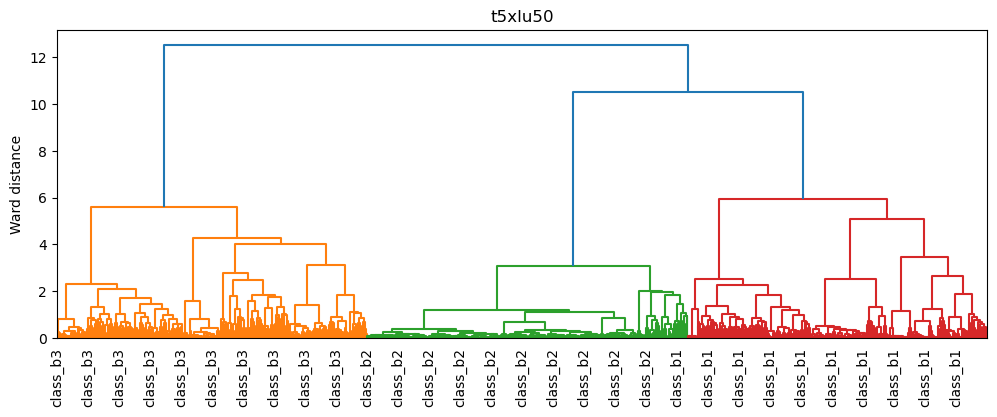

In [34]:
label="bla_class"
link_mbl_k3_esm1b     = do_linkage(data=rand_mbl, model="esm1b",     true_label=label, k=3, x=x, y=y)
link_mbl_k3_esm2_650m = do_linkage(data=rand_mbl, model="esm2_650m", true_label=label, k=3, x=x, y=y)
link_mbl_k3_esm2_3b   = do_linkage(data=rand_mbl, model="esm2_3b",   true_label=label, k=3, x=x, y=y)
link_mbl_k3_carp      = do_linkage(data=rand_mbl, model="carp",      true_label=label, k=3, x=x, y=y)
link_mbl_k3_t5xlu50   = do_linkage(data=rand_mbl, model="t5xlu50",   true_label=label, k=3, x=x, y=y)

In [35]:
link_sbl_k3 = [
    link_sbl_k3_esm1b,
    link_sbl_k3_esm2_650m,
    link_sbl_k3_esm2_3b,
    link_sbl_k3_carp,
    link_sbl_k3_t5xlu50]

link_sbl_k2 = [
    link_sbl_esm1b,
    link_sbl_esm2_650m,
    link_sbl_esm2_3b,
    link_sbl_carp,
    link_sbl_t5xlu50]

link_mbl_k3 = [
    link_mbl_k3_esm1b,
    link_mbl_k3_esm2_650m,
    link_mbl_k3_esm2_3b,
    link_mbl_k3_carp,
    link_mbl_k3_t5xlu50]

link_mbl_k2 = [
    link_mbl_esm1b,
    link_mbl_esm2_650m,
    link_mbl_esm2_3b,
    link_mbl_carp,
    link_mbl_t5xlu50]

df_link = pd.DataFrame({"model":models, "k3_SBL":link_sbl_k3, "k2_SBL":link_sbl_k2, "k3_MBL":link_mbl_k3, "k2_MBL":link_mbl_k2})
df_link = df_link.melt(id_vars=["model"])
df_link

,model,variable,value
0,esm1b,k3_SBL,0.961
1,esm2_650m,k3_SBL,0.532
2,esm2_3b,k3_SBL,0.390
3,carp,k3_SBL,0.606
4,t5xlu50,k3_SBL,0.527
5,esm1b,k2_SBL,0.947
6,esm2_650m,k2_SBL,0.947
7,esm2_3b,k2_SBL,0.239
8,carp,k2_SBL,0.997
9,t5xlu50,k2_SBL,0.217


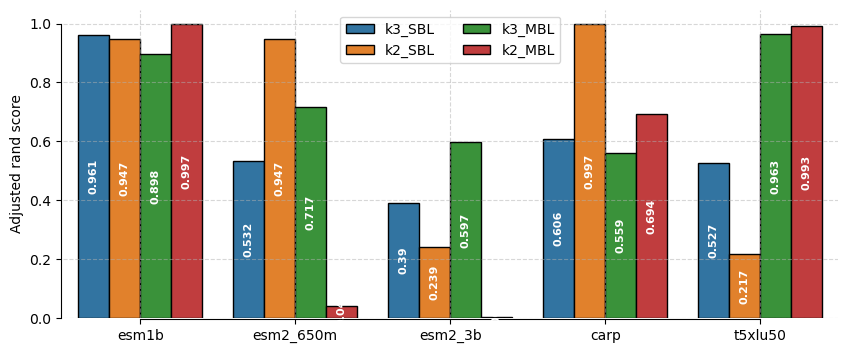

In [36]:
plt.figure(figsize=(10,4))
ax=sns.barplot(df_link, x="model", y="value", hue="variable", palette="tab10", edgecolor="k",)
plt.grid(alpha=0.5, linestyle="--")
plt.ylabel("Adjusted rand score")
plt.xlabel("")
plt.legend(title=False, ncol=2)
for idx in [0,1,2,3]:
    ax.bar_label(ax.containers[idx], rotation=90, label_type="center", color="w",weight='bold', fontsize=8)
sns.despine(trim=True, offset=1)

In [37]:
df_link.groupby('model')['value'].mean().sort_values().round(3)

model
esm2_3b      0.307
esm2_650m    0.559
t5xlu50      0.675
carp         0.714
esm1b        0.951
Name: value, dtype: float64

Text(0.5, 1.0, 'Hierarchical clustering')

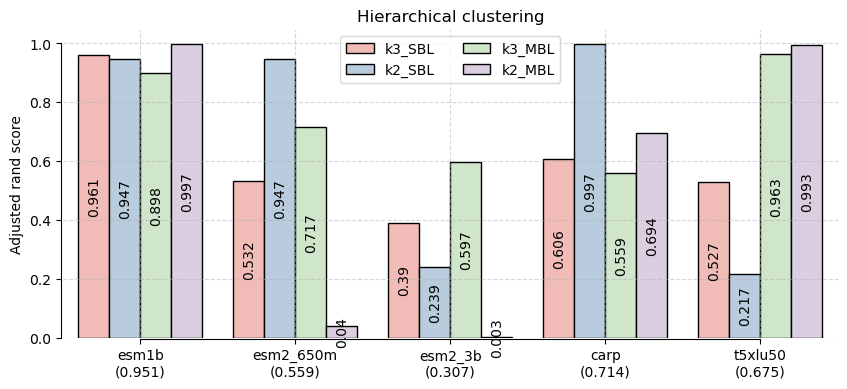

In [38]:
plt.figure(figsize=(10,4))
ax=sns.barplot(df_link, x="model", y="value", hue="variable", palette="Pastel1", edgecolor="k")
plt.grid(alpha=0.5, linestyle="--")
plt.ylabel("Adjusted rand score")
plt.xlabel("")
plt.legend(title=False, ncol=2)
for idx in [0,1,2,3]:
    ax.bar_label(ax.containers[idx], rotation=90, label_type="center", color="k", fontsize=10)
ax.set_xticklabels(["esm1b\n(0.951)","esm2_650m\n(0.559)", "esm2_3b\n(0.307)", "carp\n(0.714)", "t5xlu50\n(0.675)"])
sns.despine(trim=True, offset=1)
plt.title("Hierarchical clustering")

/home/gama/anaconda3/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/tmp/ipykernel_174780/267039409.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data["clusters"] = clusters
/tmp/ipykernel_174780/267039409.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data["clusters"] = clusters


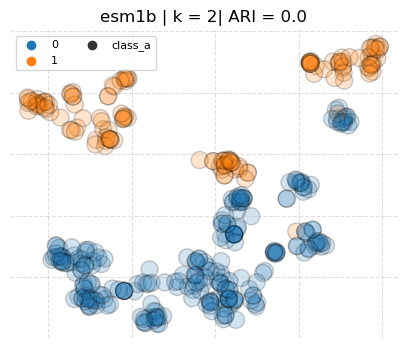

/home/gama/anaconda3/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/tmp/ipykernel_174780/267039409.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data["clusters"] = clusters
/tmp/ipykernel_174780/267039409.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data["clusters"] = clusters


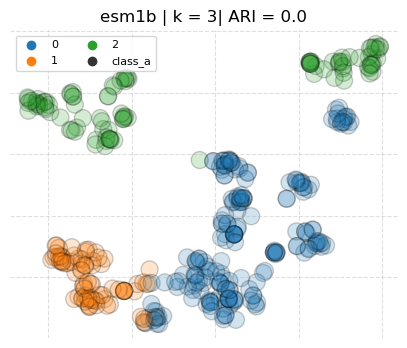

/home/gama/anaconda3/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/tmp/ipykernel_174780/267039409.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data["clusters"] = clusters
/tmp/ipykernel_174780/267039409.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data["clusters"] = clusters


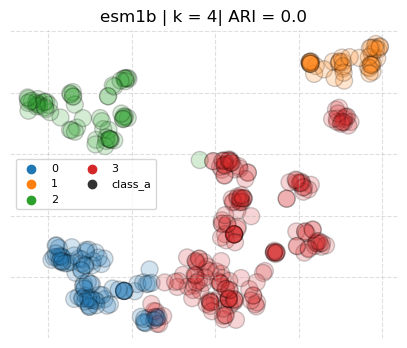

/home/gama/anaconda3/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/tmp/ipykernel_174780/267039409.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data["clusters"] = clusters
/tmp/ipykernel_174780/267039409.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data["clusters"] = clusters


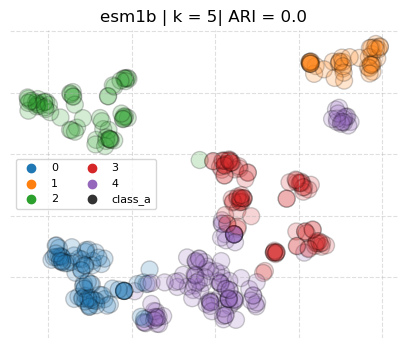

/home/gama/anaconda3/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/tmp/ipykernel_174780/267039409.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data["clusters"] = clusters
/tmp/ipykernel_174780/267039409.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data["clusters"] = clusters


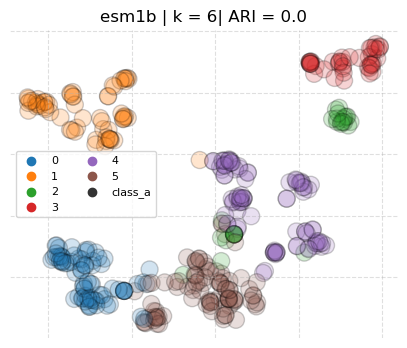

In [39]:
label="bla_class"
model="esm1b"
rand_sbl_a = rand_sbl[rand_sbl.bla_class == "class_a"]

sbl_a_k2_esm1b = do_kmeans(data=rand_sbl_a, model=model, true_label=label, k=2, x=x, y=y)
sbl_a_k3_esm1b = do_kmeans(data=rand_sbl_a, model=model, true_label=label, k=3, x=x, y=y)
sbl_a_k4_esm1b = do_kmeans(data=rand_sbl_a, model=model, true_label=label, k=4, x=x, y=y)
sbl_a_k5_esm1b = do_kmeans(data=rand_sbl_a, model=model, true_label=label, k=5, x=x, y=y)
sbl_a_k6_esm1b = do_kmeans(data=rand_sbl_a, model=model, true_label=label, k=6, x=x, y=y)

/tmp/ipykernel_174780/3825150269.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data["clusters"] = clusters


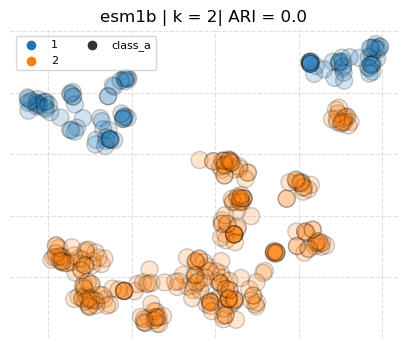

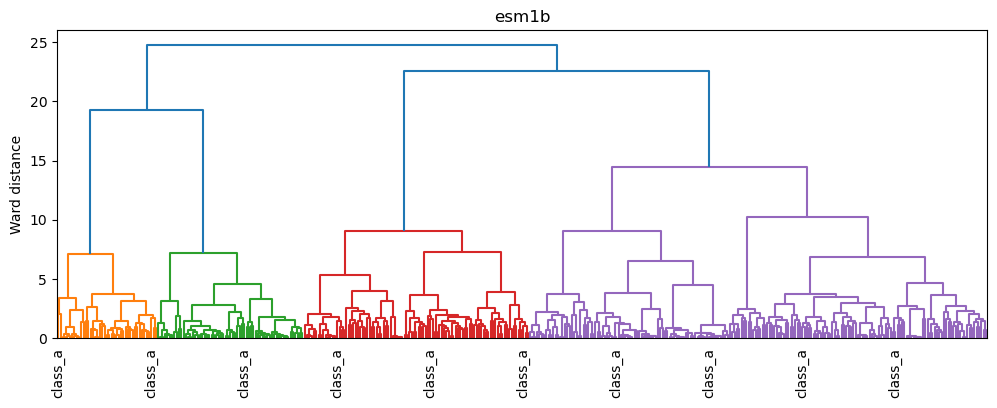

/tmp/ipykernel_174780/3825150269.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data["clusters"] = clusters


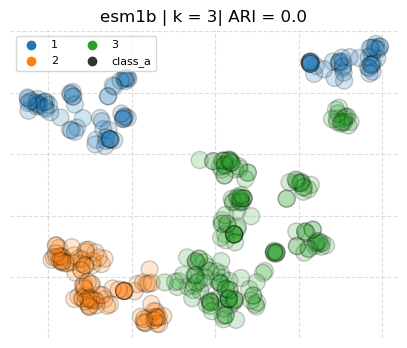

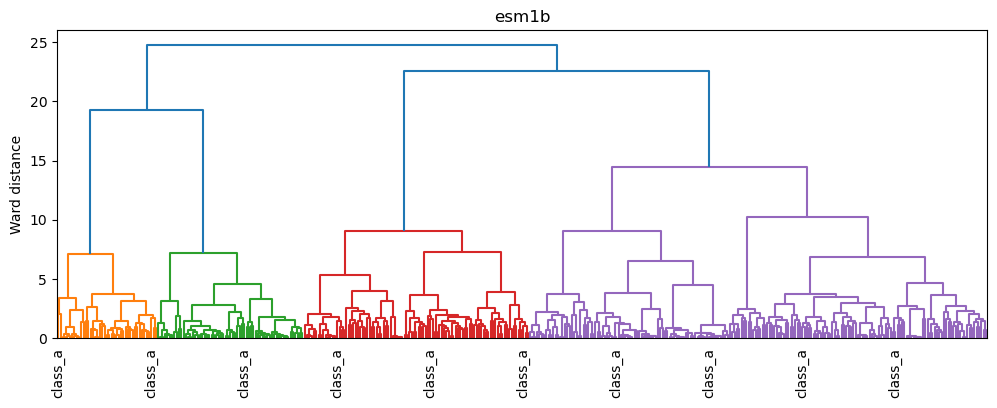

/tmp/ipykernel_174780/3825150269.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data["clusters"] = clusters


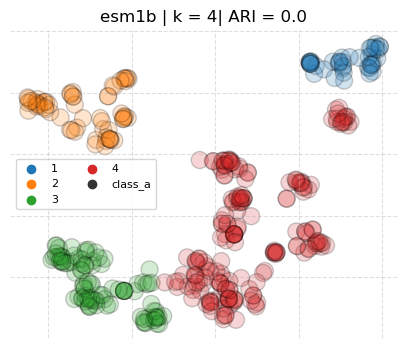

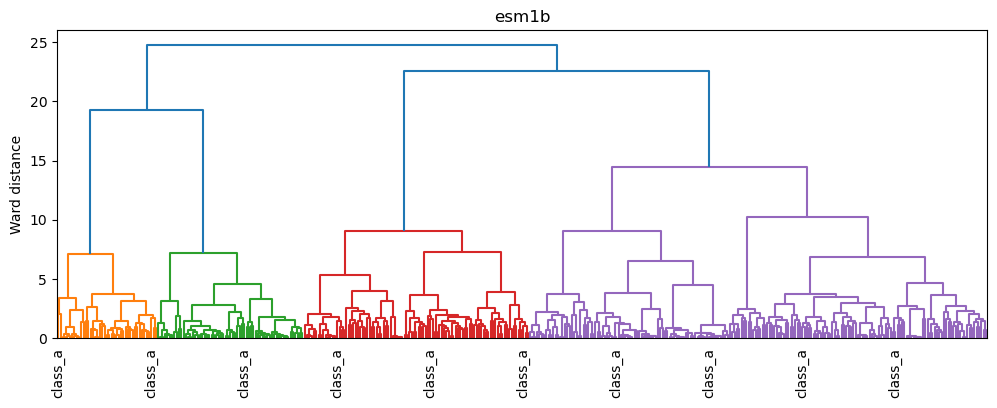

/tmp/ipykernel_174780/3825150269.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data["clusters"] = clusters


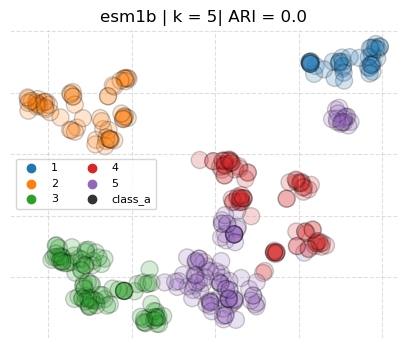

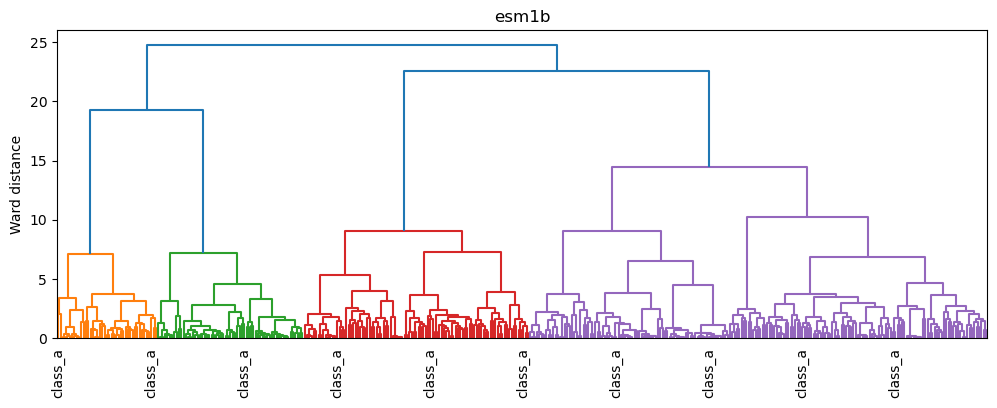

/tmp/ipykernel_174780/3825150269.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data["clusters"] = clusters


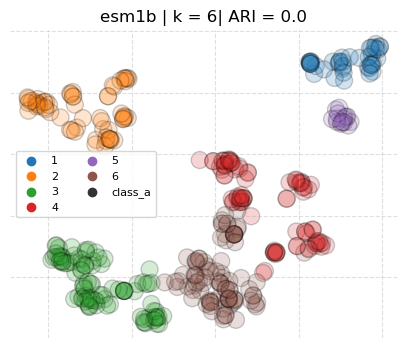

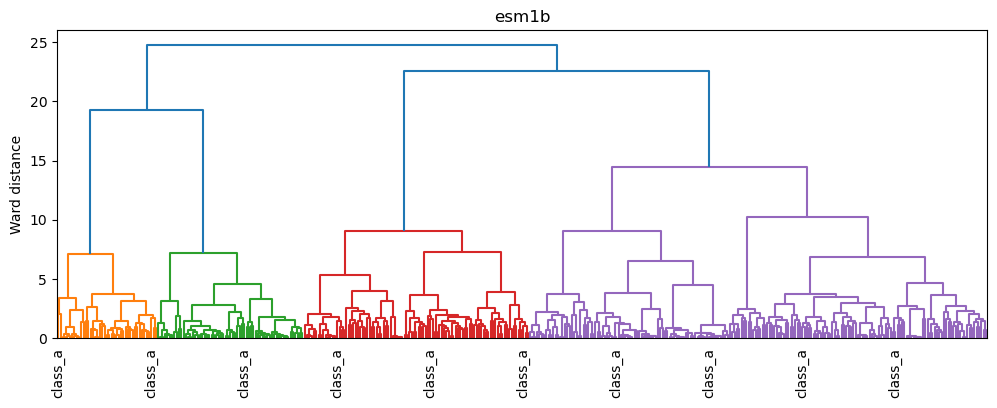

In [40]:
link_sbl_a_k2_esm1b = do_linkage(data=rand_sbl_a, model=model, true_label=label, k=2, x=x, y=y)
link_sbl_a_k3_esm1b = do_linkage(data=rand_sbl_a, model=model, true_label=label, k=3, x=x, y=y)
link_sbl_a_k4_esm1b = do_linkage(data=rand_sbl_a, model=model, true_label=label, k=4, x=x, y=y)
link_sbl_a_k5_esm1b = do_linkage(data=rand_sbl_a, model=model, true_label=label, k=5, x=x, y=y)
link_sbl_a_k6_esm1b = do_linkage(data=rand_sbl_a, model=model, true_label=label, k=6, x=x, y=y)